In [5]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
import os
import glob
import re
import numpy as np
import rasterio
from rasterio.plot import show
from rasterio.features import geometry_mask
import geopandas as gpd
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from imblearn.over_sampling import SMOTE
from sklearn.utils import resample
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import joblib
from sklearn.decomposition import PCA
import pandas as pd

In [21]:
# Define the directories containing images and shapefiles
walrus_dir = os.path.abspath("../../../")
# If this does not work replace the walrus_dir with your own path to get the data

image_dir = os.path.join(walrus_dir, "data", "train", "clipped_images")
shapefile_dir = os.path.join(walrus_dir, "data", "train", "clipped_train")
unlabeled_image_dir = os.path.join(walrus_dir, "data", "train", "clipped_unlabeled")

# Use glob to list all .tif and .shp files in the specified directories
image_paths = glob.glob(f"{image_dir}/*.tif")
shapefile_paths = glob.glob(f"{shapefile_dir}/*.shp")
unlabeled_image_paths = glob.glob(f"{unlabeled_image_dir}/*.tif")

# Function to extract island name and date from file names
def extract_island_and_date(filename):
    pattern = r'([a-zA-Z]+)_(\d{8})'
    match = re.search(pattern, filename)
    if match:
        return match.group(1), match.group(2)
    return None, None

# Create a dictionary to store paired image and shapefile paths
file_pairs = {}# Pair image and shapefile paths based on filenames
for image_path in image_paths:
    island, date = extract_island_and_date(os.path.basename(image_path))
    if island is None or date is None:
        print(f"Failed to extract island and date from {image_path}")
        continue

    matching_shapefiles = [shapefile for shapefile in shapefile_paths if island in shapefile and date in shapefile]
    if not matching_shapefiles:
        print(f"No matching shapefile found for {image_path}")
        continue

    shapefile_path = matching_shapefiles[0]
    file_pairs[image_path] = shapefile_path# Function to extract features and labels
def extract_features_labels(image_path, shapefile_path):
    with rasterio.open(image_path) as src:
        image = src.read()
        transform = src.transform

    gdf = gpd.read_file(shapefile_path)
    features = []
    labels = []
    img_name = []

    for _, row in gdf.iterrows():
        mask = geometry_mask([row['geometry']], transform=transform, invert=True, out_shape=(src.height, src.width))
        feature_pixels = image[:, mask]
        label = row['label']

        for pixel in feature_pixels.T:  # Transpose to iterate over pixels
            features.append(pixel)
            labels.append(label)
            img_name.append(image_path)

    return np.array(features), np.array(labels), np.array(img_name)

features = []
labels = []
image_name = []

for image_path, shapefile_path in file_pairs.items():
    img_features, img_labels, img_name = extract_features_labels(image_path, shapefile_path)
    features.append(img_features)
    labels.append(img_labels)
    image_name.append(img_name)

features = np.vstack(features)
labels = np.hstack(labels)
image_name = np.hstack(image_name)
print(features, labels, image_name)

# Encode labels
le = LabelEncoder()
encoded_labels = le.fit_transform(labels)

# Create DataFrame
dataset = pd.DataFrame({'Coast_blue': features[:, 0],
                        'Blue': features[:, 1],
                        'Green1': features[:, 2],
                        'Green': features[:, 3],
                        'Yellow': features[:, 4],
                        'Red': features[:, 5],
                        'Red_edge': features[:, 6],
                        'NIR': features[:, 7],
                        'labels': labels,
                        'image_name': image_name})

No matching shapefile found for E:\PycharmProjects\nina\walrus\data\train\clipped_images\pool_20230803_image.tif
[[1272 1023 1317 ... 1309 1387 1345]
 [1270 1022 1297 ... 1299 1417 1328]
 [1317 1054 1319 ... 1328 1429 1254]
 ...
 [1730 1870 1929 ... 2091 2276 2647]
 [1634 1851 1879 ... 2053 2281 2634]
 [1720 1904 1905 ... 2135 2316 2654]] ['ocean' 'ocean' 'ocean' ... 'freshwater' 'freshwater' 'freshwater'] ['E:\\PycharmProjects\\nina\\walrus\\data\\train\\clipped_images\\buch_20230714_image.tif'
 'E:\\PycharmProjects\\nina\\walrus\\data\\train\\clipped_images\\buch_20230714_image.tif'
 'E:\\PycharmProjects\\nina\\walrus\\data\\train\\clipped_images\\buch_20230714_image.tif'
 ...
 'E:\\PycharmProjects\\nina\\walrus\\data\\train\\clipped_images\\tor_20230902_image.tif'
 'E:\\PycharmProjects\\nina\\walrus\\data\\train\\clipped_images\\tor_20230902_image.tif'
 'E:\\PycharmProjects\\nina\\walrus\\data\\train\\clipped_images\\tor_20230902_image.tif']


In [21]:
# Function to plot 2D space
def plot_2d_space(X, y, label='Classes', class_names=None, color_map=None):
    markers = ['o', 's', 'D', 'v', '^', '<', '>', '8', 'p', '*']
    for l, m in zip(np.unique(y), markers):
        plt.scatter(
            X[y==l, 0],
            X[y==l, 1],
            c=color_map[class_names[l]] if color_map else 'black',
            label=class_names[l] if class_names is not None else l,
            marker=m,
            s=10,
            alpha=0.5
        )
    plt.title(label)
    plt.legend(loc='upper right')
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    plt.show()

# Function to plot 3D space
def plot_3d_space(X, y, label='Classes', class_names=None, color_map=None):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.view_init(azim=270)
    markers = ['o', 's', 'D', 'v', '^', '<', '>', '8', 'p', '*']
    for l, m in zip(np.unique(y), markers):
        ax.scatter(
            X[y==l, 0],
            X[y==l, 1],
            X[y==l, 2],
            c=color_map[class_names[l]] if color_map else 'black',
            label=class_names[l] if class_names is not None else l,
            marker=m,
            s=10,
            alpha=0.5
        )
    plt.title(label)
    ax.legend(loc='upper right')
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    ax.set_zlabel('PCA Component 3')
    plt.show()

# Get class names for the legend
class_names = le.inverse_transform(np.unique(encoded_labels))


PCA with 2 components:
Explained variance ratio: [0.94210677 0.04461483]
Cumulative explained variance ratio: 0.9867215995458742


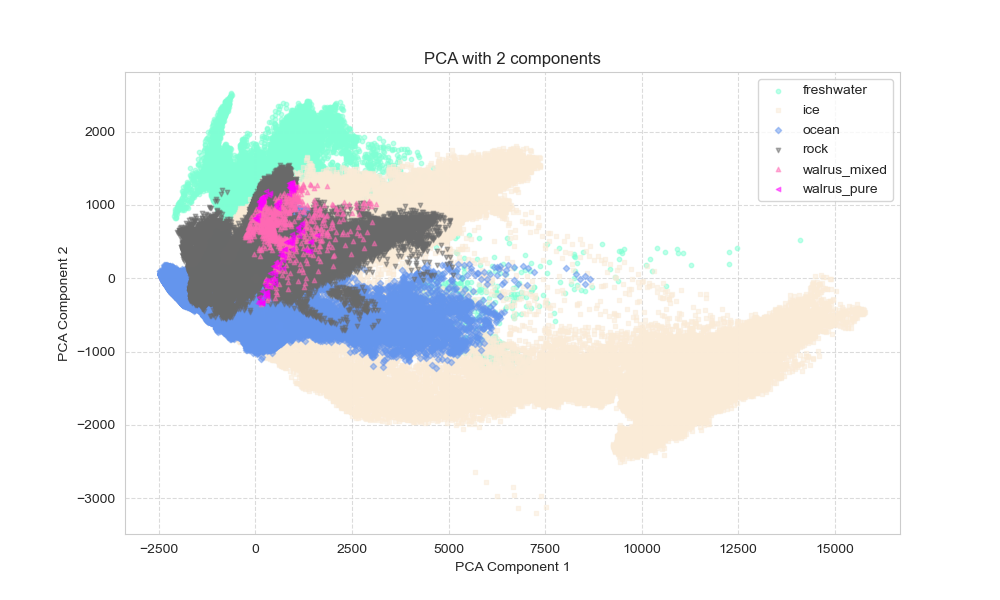


PCA with 3 components:
Explained variance ratio: [0.94210677 0.04461483 0.00816457]
Cumulative explained variance ratio: 0.9948861699049051


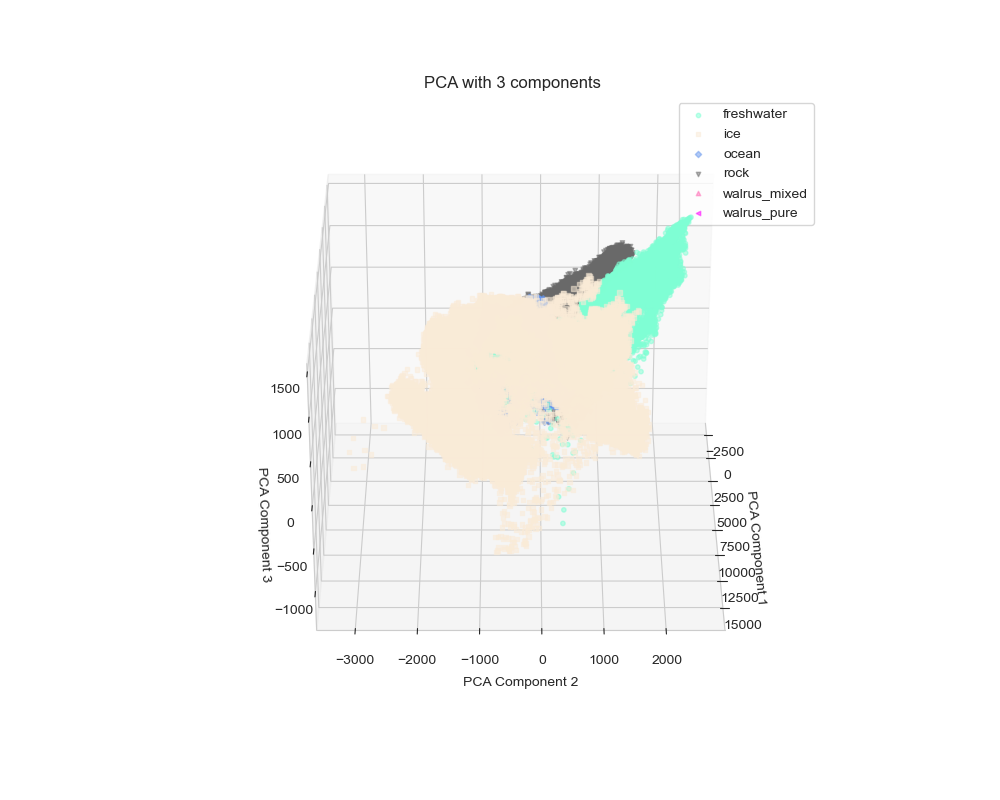


PCA with 4 components:
Explained variance ratio: [0.94210677 0.04461483 0.00816457 0.0034075 ]
Cumulative explained variance ratio: 0.9982936737698495


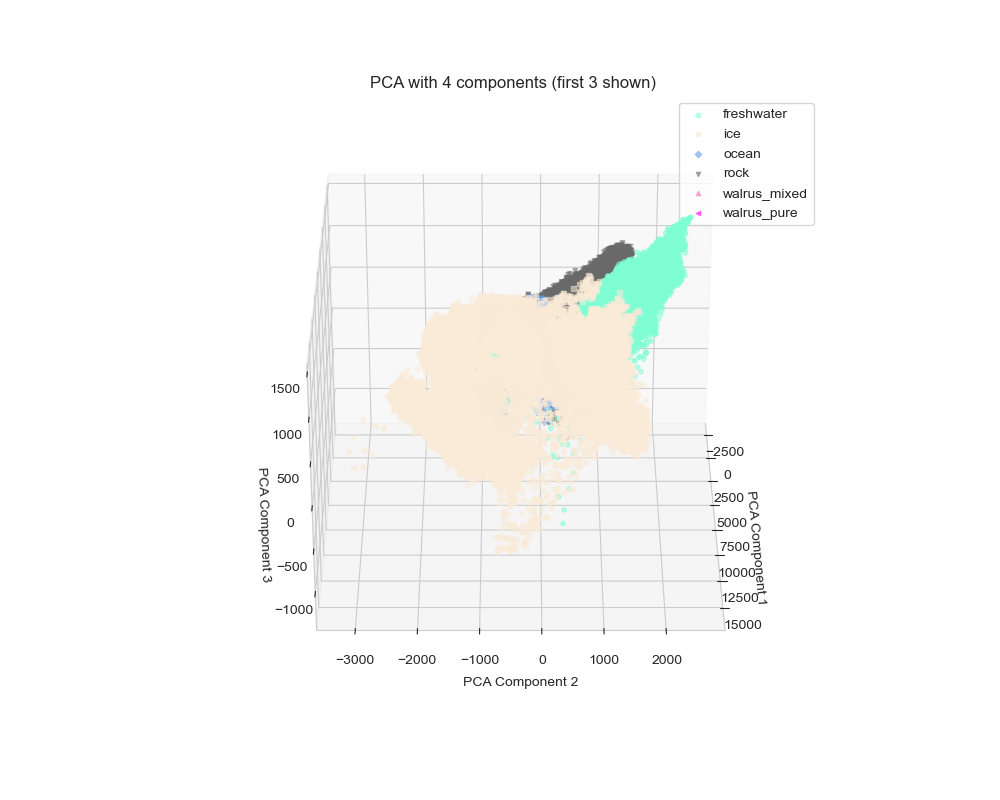


PCA with 5 components:
Explained variance ratio: [9.42106771e-01 4.46148284e-02 8.16457036e-03 3.40750386e-03
 8.42840859e-04]
Cumulative explained variance ratio: 0.9991365146285311


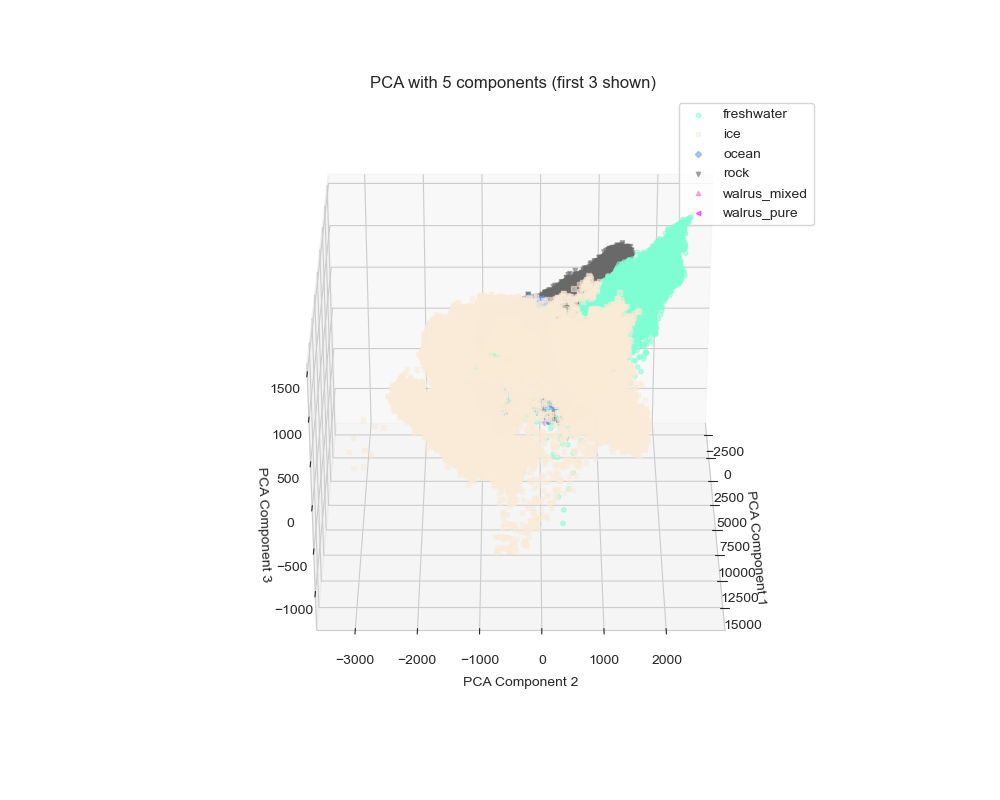


PCA with 6 components:
Explained variance ratio: [9.42106771e-01 4.46148284e-02 8.16457036e-03 3.40750386e-03
 8.42840859e-04 4.09272233e-04]
Cumulative explained variance ratio: 0.9995457868614493


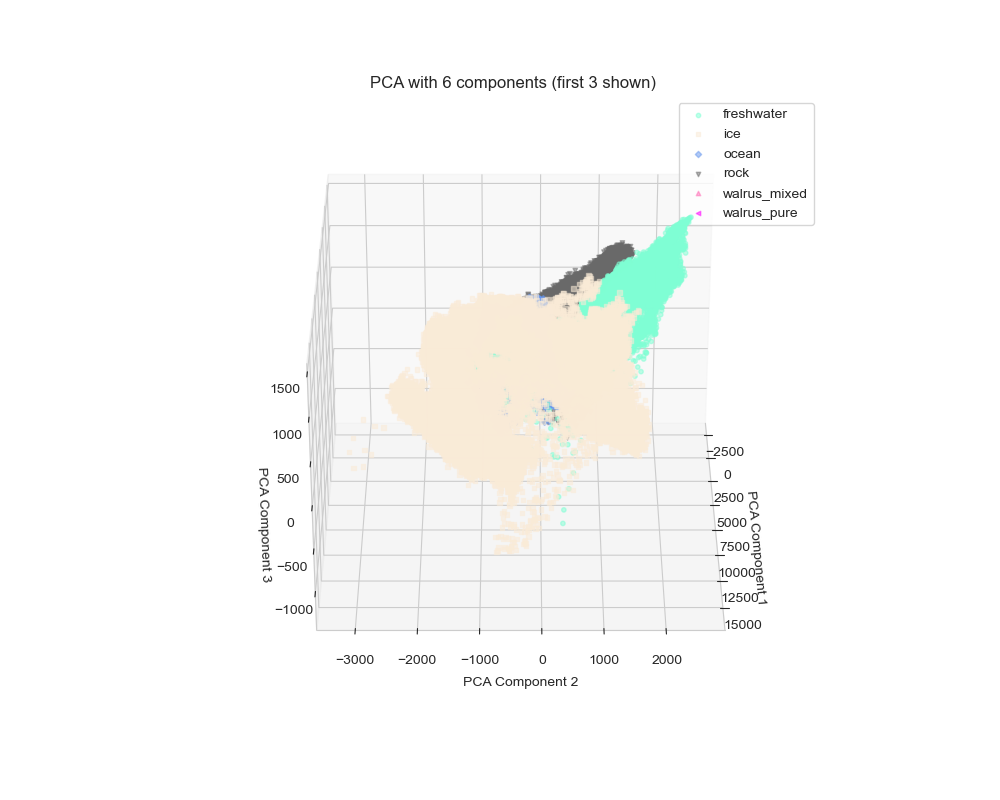

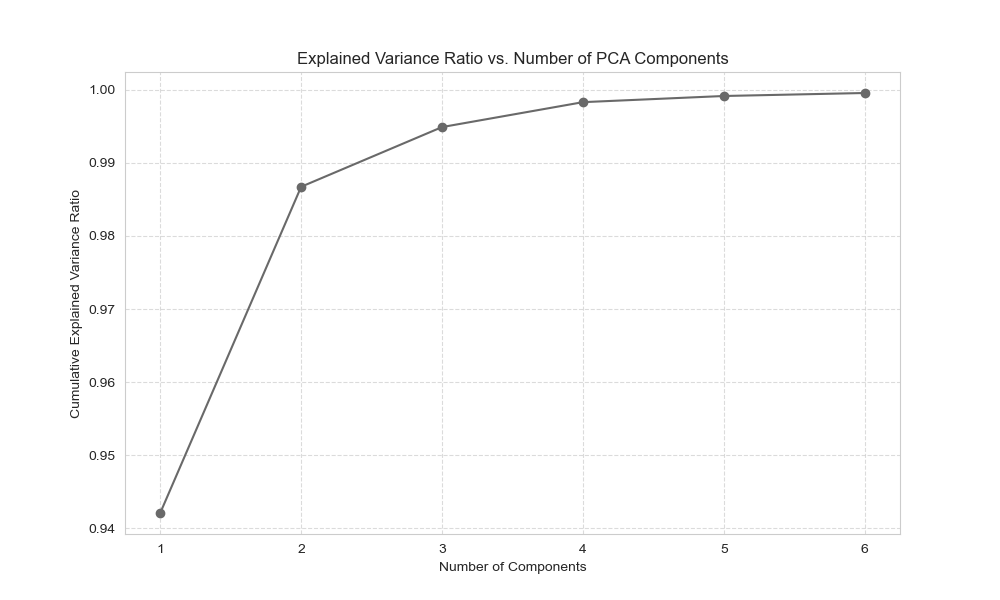

In [10]:
# Define the color map
label_colors = {'ice': 'antiquewhite', 'rock': 'dimgray', 'walrus_pure': 'fuchsia', 'walrus_mixed': 'hotpink', 'freshwater': 'aquamarine', 'ocean': 'cornflowerblue'}
class_color_map = {class_name: label_colors[class_name] for class_name in class_names}

# Perform PCA with increasing number of components
max_components = min(6, features.shape[1])  # Use up to 8 components or the number of features, whichever is smaller

for n_components in range(2, max_components + 1):
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(features)
    
    print(f"\nPCA with {n_components} components:")
    print(f"Explained variance ratio: {pca.explained_variance_ratio_}")
    print(f"Cumulative explained variance ratio: {np.sum(pca.explained_variance_ratio_)}")
    
    if n_components == 2:
        plot_2d_space(X_pca, encoded_labels, f'PCA with {n_components} components', class_names, class_color_map)
    elif n_components == 3:
        plot_3d_space(X_pca, encoded_labels, f'PCA with {n_components} components', class_names, class_color_map)
    else:
        # For more than 3 components, we'll plot the first 3 principal components
        plot_3d_space(X_pca[:, :3], encoded_labels, f'PCA with {n_components} components (first 3 shown)', class_names, class_color_map)

# Plot explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(range(1, max_components + 1), np.cumsum(pca.explained_variance_ratio_), 'o-', color='dimgray')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Explained Variance Ratio vs. Number of PCA Components')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import plotly.express as px
import pandas as pd

In [2]:
def plot_pca_components_2d(X_pca, y, pca, n_components, label='Classes', class_names=None, color_map=None):
    # Get the indices of the components that explain the most variance
    top_components = pca.explained_variance_ratio_.argsort()[-n_components:][::-1]
    
    fig, axes = plt.subplots(n_components, n_components, figsize=(15, 15))
    fig.suptitle(f'{label} - Pairwise Component Comparisons', fontsize=16)
    
    for i, j in itertools.combinations(range(n_components), 2):
        ax = axes[i, j]
        for l in np.unique(y):
            ax.scatter(
                X_pca[y==l, top_components[j]],
                X_pca[y==l, top_components[i]],
                c=color_map[class_names[l]] if color_map else 'black',
                label=class_names[l] if class_names is not None else l,
                s=5,
                alpha=0.3
            )
        ax.set_xlabel(f'PCA Component {top_components[j]+1}')
        ax.set_ylabel(f'PCA Component {top_components[i]+1}')
        
        if i == 0 and j == n_components-1:
            ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    plt.tight_layout()
    plt.show()

    # Print the explained variance for the plotted components
    print(f"Explained variance ratios for components {', '.join(str(i+1) for i in top_components)}:")
    print(pca.explained_variance_ratio_[top_components])

In [3]:
# Perform PCA with increasing number of components
max_components = min(8, features.shape[1])

for n_components in range(2, max_components + 1):
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(features)
    
    print(f"\nPCA with {n_components} components:")
    print(f"Explained variance ratio: {pca.explained_variance_ratio_}")
    print(f"Cumulative explained variance ratio: {np.sum(pca.explained_variance_ratio_)}")
    
    if n_components == 2:
        plot_2d_space(X_pca, encoded_labels, f'PCA with {n_components} components', class_names, class_color_map)
    else:
        plot_pca_components_2d(X_pca, encoded_labels, pca, n_components, f'PCA with {n_components} components', class_names, class_color_map)
        plot_interactive_3d(X_pca, encoded_labels, pca, f'PCA with {n_components} components', class_names, class_color_map)

# Plot explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(range(1, max_components + 1), np.cumsum(pca.explained_variance_ratio_), 'o-', color='dimgray')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Explained Variance Ratio vs. Number of PCA Components')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

# Scatter plot matrix for all components
plt.figure(figsize=(20, 20))
sns.pairplot(pd.DataFrame(X_pca, columns=[f'PC{i+1}' for i in range(X_pca.shape[1])]).assign(Class=[class_names[label] for label in encoded_labels]),
             hue='Class', plot_kws={'alpha': 0.3, 's': 5})
plt.suptitle('Scatter Plot Matrix of PCA Components', y=1.02)
plt.show()

NameError: name 'features' is not defined

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
import os
import glob
import re
import rasterio
from rasterio.plot import show
from rasterio.features import geometry_mask
import geopandas as gpd
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from imblearn.over_sampling import SMOTE
from sklearn.utils import resample
import joblib
import pandas as pd
import seaborn as sns
import itertools
from scipy.spatial import ConvexHull

In [13]:
# Define the directories containing images and shapefiles
image_dir = "C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images"
shapefile_dir = "C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_train"
unlabeled_image_dir = "C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_unlabeled"

# Use glob to list all .tif and .shp files in the specified directories
image_paths = glob.glob(f"{image_dir}/*.tif")
shapefile_paths = glob.glob(f"{shapefile_dir}/*.shp")
unlabeled_image_paths = glob.glob(f"{unlabeled_image_dir}/*.tif")

# Function to extract island name and date from file names
def extract_island_and_date(filename):
    pattern = r'([a-zA-Z]+)_(\d{8})'
    match = re.search(pattern, filename)
    if match:
        return match.group(1), match.group(2)
    return None, None

# Create a dictionary to store paired image and shapefile paths
file_pairs = {}

# Pair image and shapefile paths based on filenames
for image_path in image_paths:
    island, date = extract_island_and_date(os.path.basename(image_path))
    if island is None or date is None:
        print(f"Failed to extract island and date from {image_path}")
        continue

    matching_shapefiles = [shapefile for shapefile in shapefile_paths if island in shapefile and date in shapefile]
    if not matching_shapefiles:
        print(f"No matching shapefile found for {image_path}")
        continue

    shapefile_path = matching_shapefiles[0]
    file_pairs[image_path] = shapefile_path

# Function to extract features and labels
def extract_features_labels(image_path, shapefile_path):
    with rasterio.open(image_path) as src:
        image = src.read()
        transform = src.transform

    gdf = gpd.read_file(shapefile_path)
    features = []
    labels = []
    img_name = []

    for _, row in gdf.iterrows():
        mask = geometry_mask([row['geometry']], transform=transform, invert=True, out_shape=(src.height, src.width))
        feature_pixels = image[:, mask]
        label = row['label']

        for pixel in feature_pixels.T:  # Transpose to iterate over pixels
            features.append(pixel)
            labels.append(label)
            img_name.append(image_path)

    return np.array(features), np.array(labels), np.array(img_name)

features = []
labels = []
image_name = []

for image_path, shapefile_path in file_pairs.items():
    img_features, img_labels, img_name = extract_features_labels(image_path, shapefile_path)
    features.append(img_features)
    labels.append(img_labels)
    image_name.append(img_name)

features = np.vstack(features)
labels = np.hstack(labels)
image_name = np.hstack(image_name)
print(features, labels, image_name)

# Encode labels
le = LabelEncoder()
encoded_labels = le.fit_transform(labels)

# Create DataFrame
dataset = pd.DataFrame({'Coast_blue': features[:, 0],
                        'Blue': features[:, 1],
                        'Green1': features[:, 2],
                        'Green': features[:, 3],
                        'Yellow': features[:, 4],
                        'Red': features[:, 5],
                        'Red_edge': features[:, 6],
                        'NIR': features[:, 7],
                        'labels': labels,
                        'image_name': image_name})


No matching shapefile found for C:\Users\Student\Documents\101_walrus_data\train\clipped_images\pool_20230803_image.tif
[[1187  980 1269 ... 1329 1416 1650]
 [1148  912 1212 ... 1240 1297 1612]
 [1131  856 1162 ... 1181 1355 1510]
 ...
 [1730 1870 1929 ... 2091 2276 2647]
 [1634 1851 1879 ... 2053 2281 2634]
 [1720 1904 1905 ... 2135 2316 2654]] ['walrus_mixed' 'walrus_mixed' 'walrus_mixed' ... 'freshwater'
 'freshwater' 'freshwater'] ['C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\buch_20230714_image.tif'
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\buch_20230714_image.tif'
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\buch_20230714_image.tif'
 ...
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\tor_20230902_image.tif'
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\tor_20230902_image.tif'
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_ima

In [14]:
def plot_pca_components_2d(X_pca, y, pca, n_components, label='Classes', class_names=None, color_map=None):
    # Get the indices of the components that explain the most variance
    top_components = pca.explained_variance_ratio_.argsort()[-n_components:][::-1]
    
    fig, axes = plt.subplots(n_components, n_components, figsize=(15, 15))
    fig.suptitle(f'{label} - Pairwise Component Comparisons', fontsize=16)
    
    for i, j in itertools.combinations(range(n_components), 2):
        ax = axes[i, j]
        for l in np.unique(y):
            class_mask = y == l
            ax.scatter(
                X_pca[class_mask, top_components[j]],
                X_pca[class_mask, top_components[i]],
                c=color_map[class_names[l]] if color_map else 'black',
                label=class_names[l] if class_names is not None else l,
                s=5,
                alpha=0.3
            )
            if class_mask.sum() > 2:  # Check if there are enough points to form a hull
                hull = ConvexHull(X_pca[class_mask][:, [top_components[j], top_components[i]]])
                for simplex in hull.simplices:
                    ax.plot(X_pca[class_mask][simplex, top_components[j]],
                            X_pca[class_mask][simplex, top_components[i]], color=color_map[class_names[l]] if color_map else 'black')
        ax.set_xlabel(f'PCA Component {top_components[j]+1}')
        ax.set_ylabel(f'PCA Component {top_components[i]+1}')
        
        if i == 0 and j == n_components-1:
            ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    plt.tight_layout()
    plt.show()

    # Print the explained variance for the plotted components
    print(f"Explained variance ratios for components {', '.join(str(i+1) for i in top_components)}:")
    print(pca.explained_variance_ratio_[top_components])


PCA with 2 components:
Explained variance ratio: [0.94210644 0.04461492]
Cumulative explained variance ratio: 0.9867213662598625


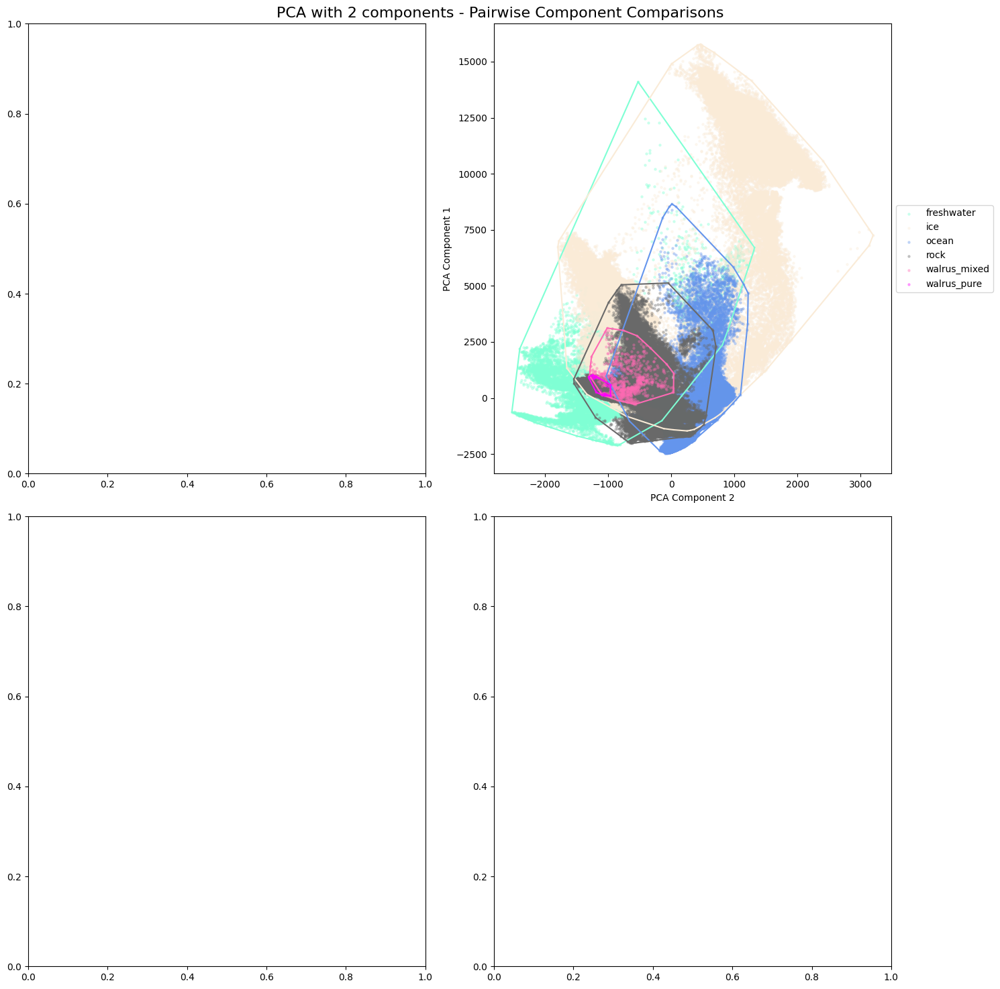

Explained variance ratios for components 1, 2:
[0.94210644 0.04461492]

PCA with 3 components:
Explained variance ratio: [0.94210644 0.04461492 0.00816484]
Cumulative explained variance ratio: 0.9948862058071811


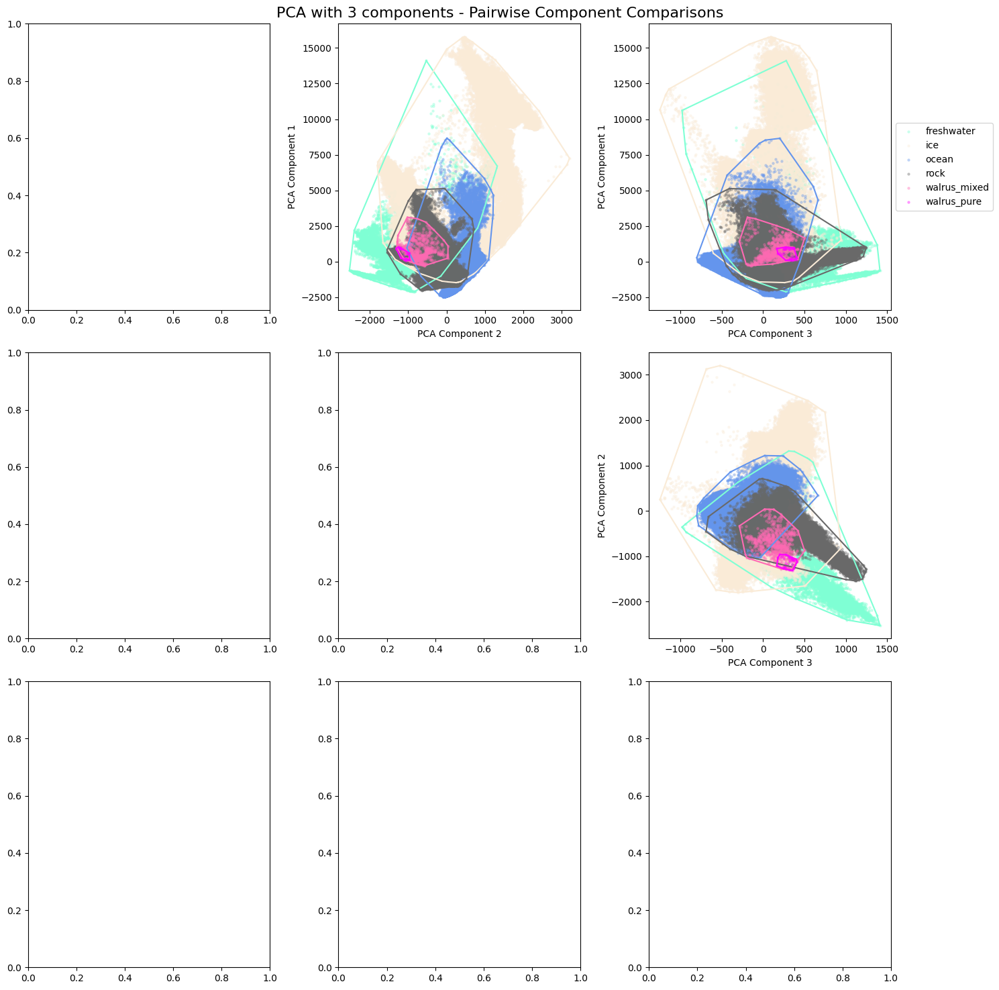

Explained variance ratios for components 1, 2, 3:
[0.94210644 0.04461492 0.00816484]

PCA with 4 components:
Explained variance ratio: [0.94210644 0.04461492 0.00816484 0.00340751]
Cumulative explained variance ratio: 0.9982937144790385


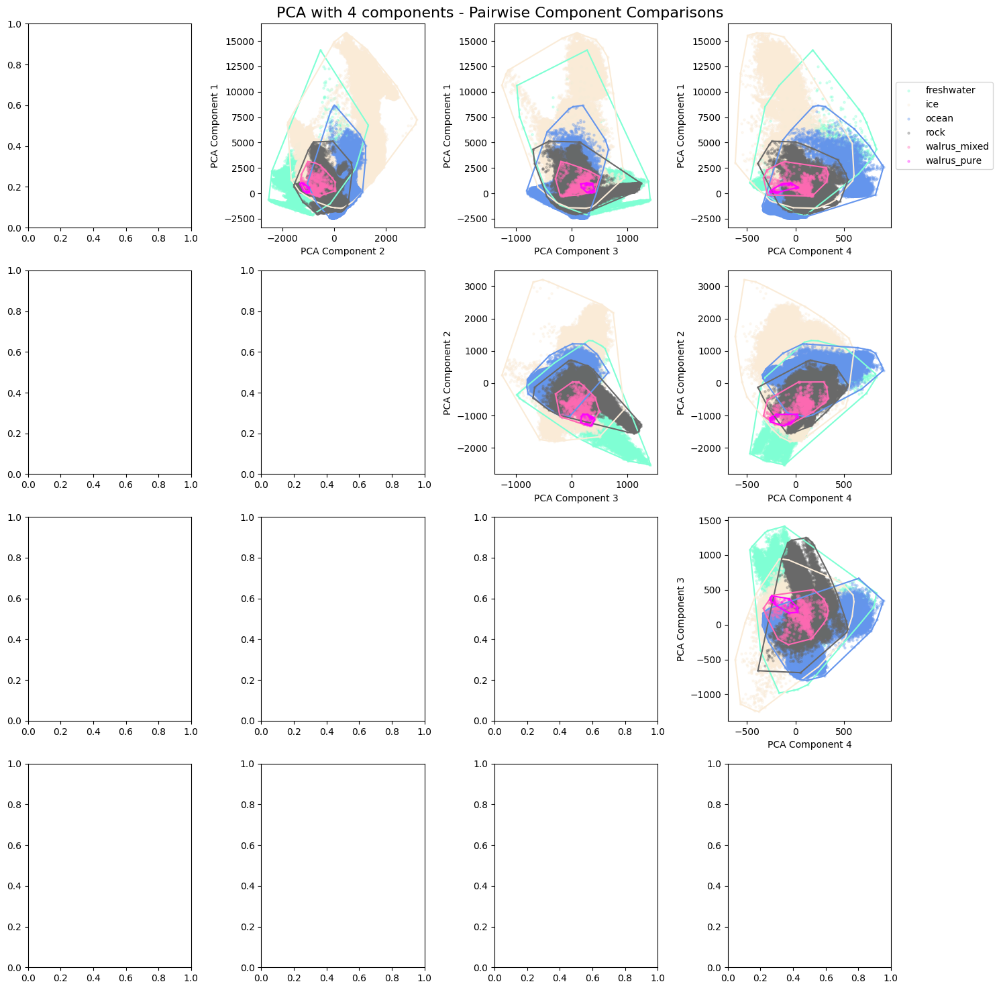

Explained variance ratios for components 1, 2, 3, 4:
[0.94210644 0.04461492 0.00816484 0.00340751]

PCA with 5 components:
Explained variance ratio: [9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04]
Cumulative explained variance ratio: 0.9991365495470554


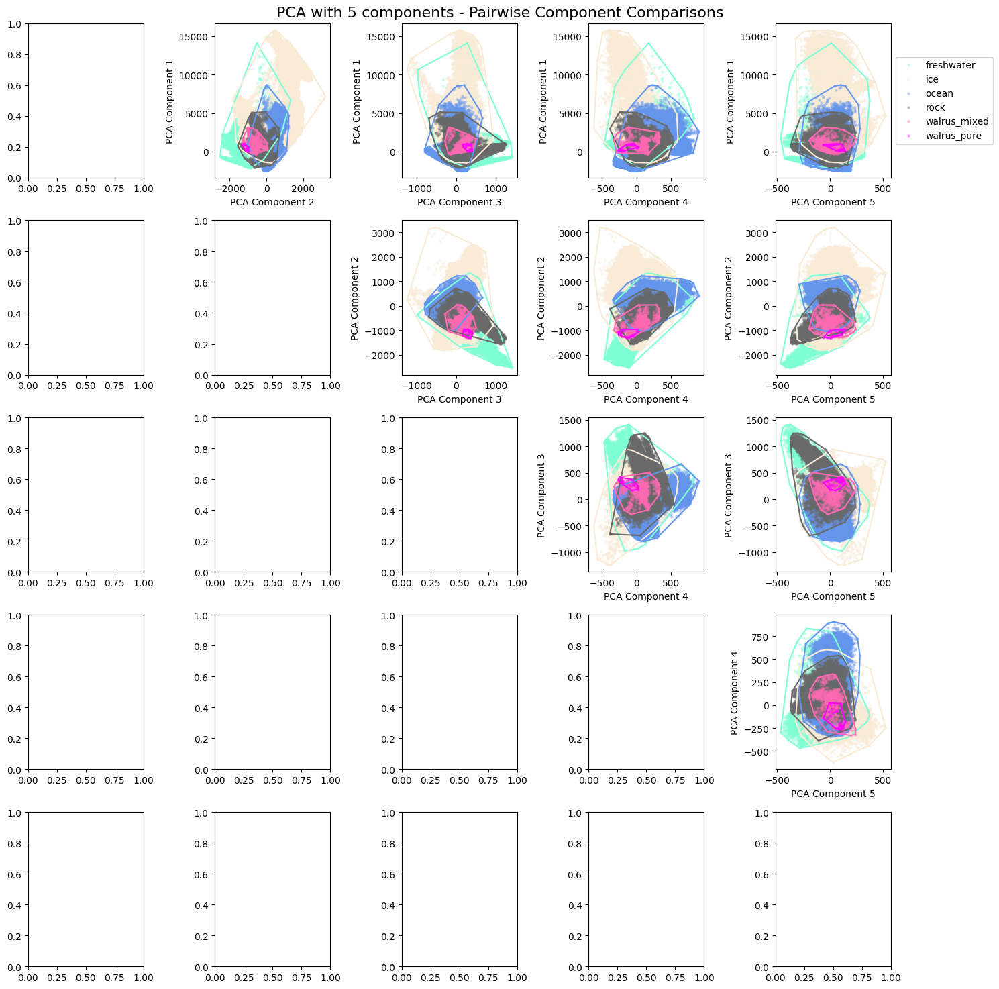

Explained variance ratios for components 1, 2, 3, 4, 5:
[9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04]

PCA with 6 components:
Explained variance ratio: [9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04 4.09254632e-04]
Cumulative explained variance ratio: 0.9995458041795163


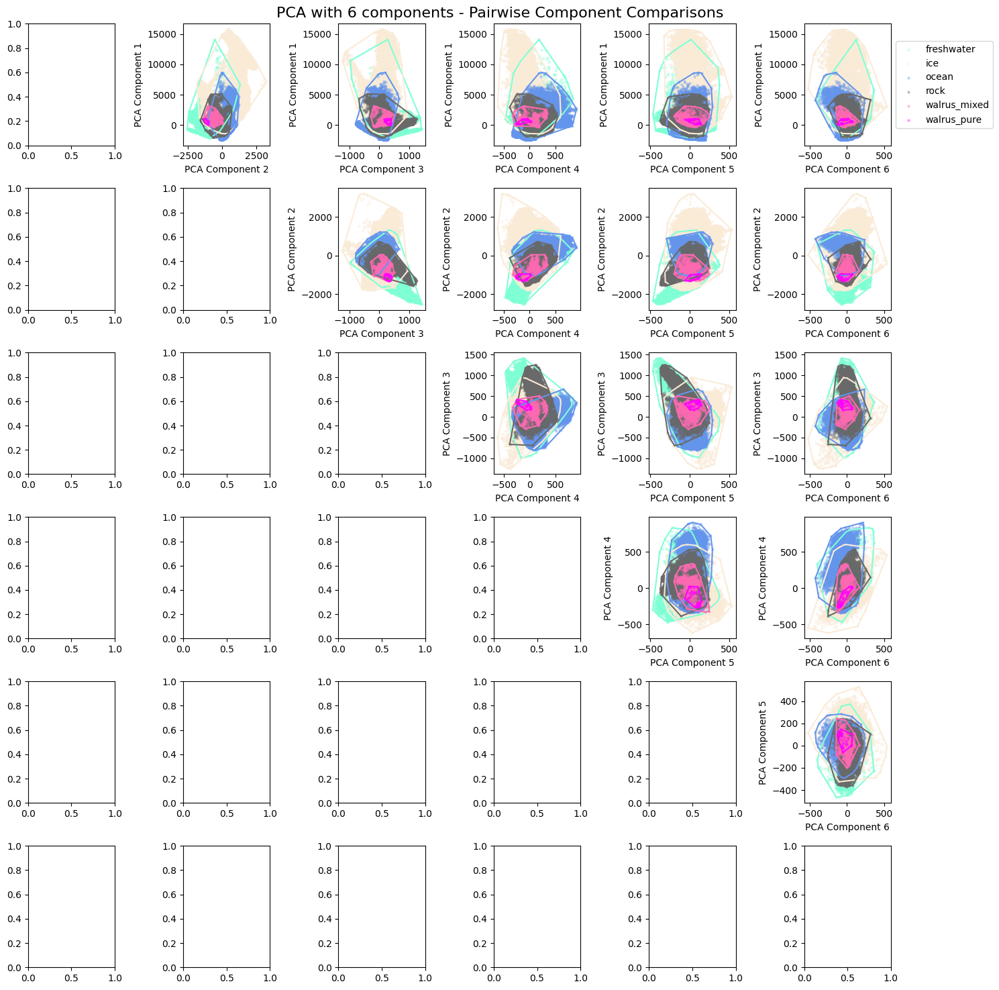

Explained variance ratios for components 1, 2, 3, 4, 5, 6:
[9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04 4.09254632e-04]

PCA with 7 components:
Explained variance ratio: [9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04 4.09254632e-04 2.65229527e-04]
Cumulative explained variance ratio: 0.9998110337064043


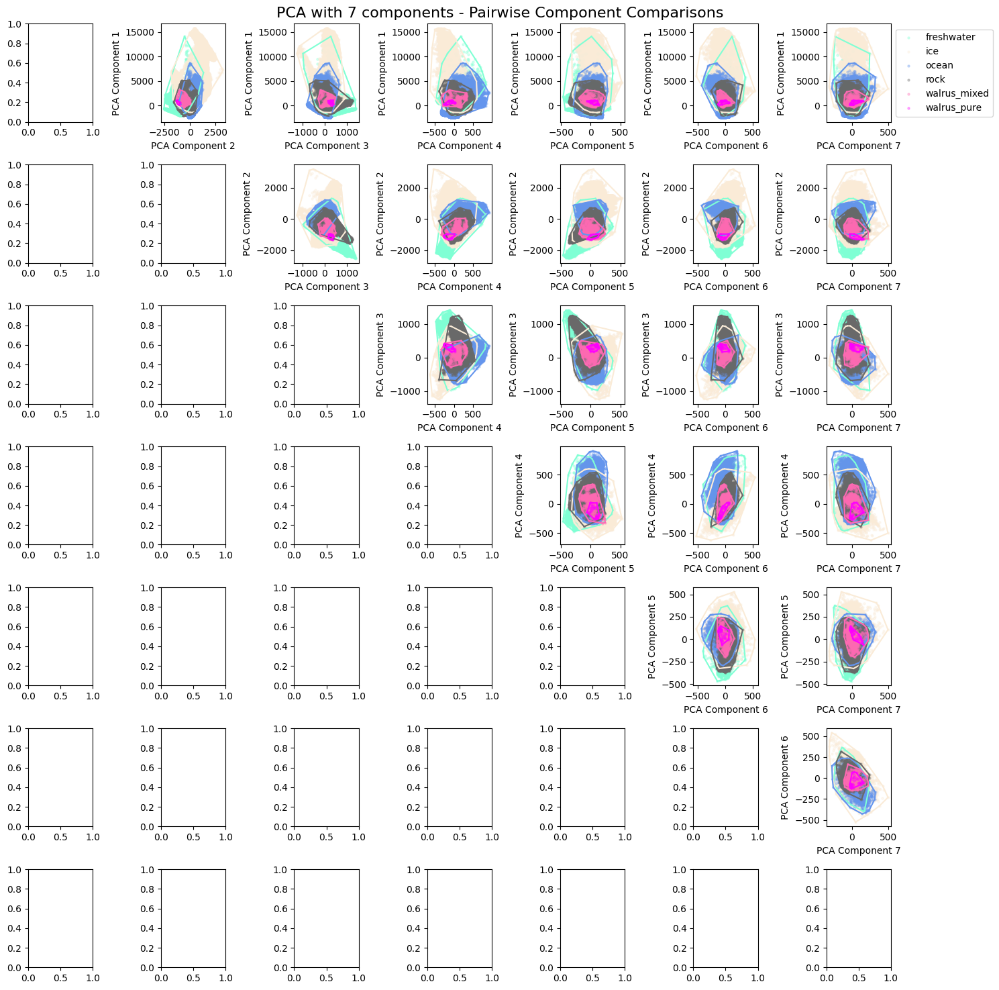

Explained variance ratios for components 1, 2, 3, 4, 5, 6, 7:
[9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04 4.09254632e-04 2.65229527e-04]

PCA with 8 components:
Explained variance ratio: [9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04 4.09254632e-04 2.65229527e-04 1.88966294e-04]
Cumulative explained variance ratio: 1.0


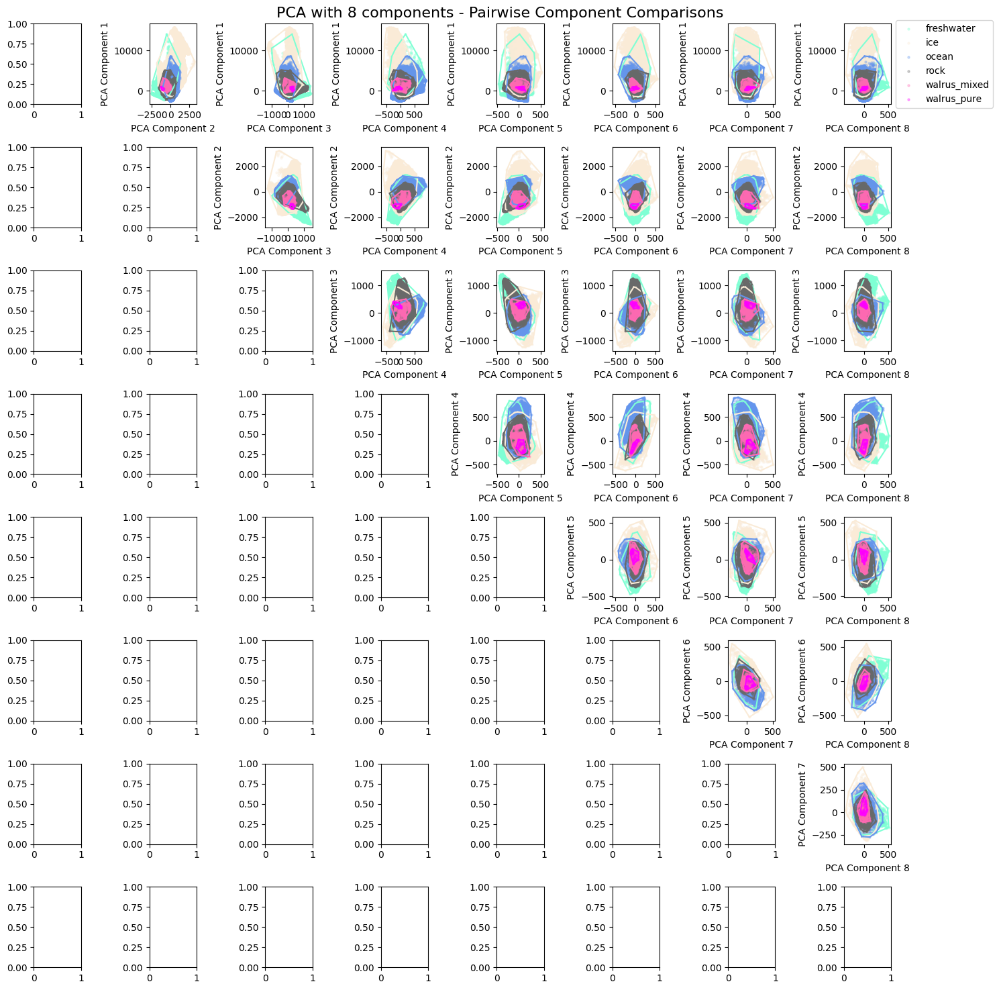

Explained variance ratios for components 1, 2, 3, 4, 5, 6, 7, 8:
[9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04 4.09254632e-04 2.65229527e-04 1.88966294e-04]


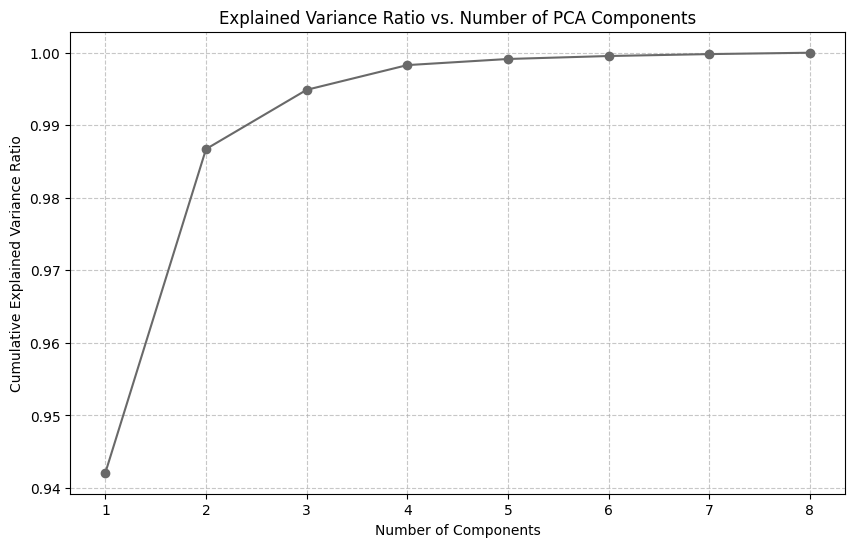

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x000002A51ACC7B50>>
Traceback (most recent call last):
  File "C:\Users\Student\Documents\walrus_code\.venv\lib\site-packages\ipykernel\ipkernel.py", line 790, in _clean_thread_parent_frames
    active_threads = {thread.ident for thread in threading.enumerate()}
KeyboardInterrupt: 

KeyboardInterrupt



<Figure size 2000x2000 with 0 Axes>

In [ ]:
# Perform PCA with increasing number of components
max_components = min(6, features.shape[1])

for n_components in range(2, max_components + 1):
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(features)
    
    print(f"\nPCA with {n_components} components:")
    print(f"Explained variance ratio: {pca.explained_variance_ratio_}")
    print(f"Cumulative explained variance ratio: {np.sum(pca.explained_variance_ratio_)}")
    
    if n_components == 2:
        plot_pca_components_2d(X_pca, encoded_labels, pca, n_components, f'PCA with {n_components} components', class_names, class_color_map)
    else:
        plot_pca_components_2d(X_pca, encoded_labels, pca, n_components, f'PCA with {n_components} components', class_names, class_color_map)
        # Assuming `plot_interactive_3d` is defined elsewhere
        # plot_interactive_3d(X_pca, encoded_labels, pca, f'PCA with {n_components} components', class_names, class_color_map)

# Plot explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(range(1, max_components + 1), np.cumsum(pca.explained_variance_ratio_), 'o-', color='dimgray')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Explained Variance Ratio vs. Number of PCA Components')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

# Scatter plot matrix for all components
plt.figure(figsize=(20, 20))
sns.pairplot(pd.DataFrame(X_pca, columns=[f'PC{i+1}' for i in range(X_pca.shape[1])]).assign(Class=[class_names[label] for label in encoded_labels]),
             hue='Class', plot_kws={'alpha': 0.3, 's': 5})
plt.suptitle('Scatter Plot Matrix of PCA Components', y=1.02)
plt.show()


In [3]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder
import os
import glob
import re
import rasterio
from rasterio.plot import show
from rasterio.features import geometry_mask
import geopandas as gpd
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from imblearn.over_sampling import SMOTE
from sklearn.utils import resample
import joblib
import pandas as pd
import seaborn as sns
import itertools
from scipy.spatial import ConvexHull

In [6]:
# Define the directories containing images and shapefiles
image_dir = "C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images"
shapefile_dir = "C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_train"
unlabeled_image_dir = "C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_unlabeled"

# Use glob to list all .tif and .shp files in the specified directories
image_paths = glob.glob(f"{image_dir}/*.tif")
shapefile_paths = glob.glob(f"{shapefile_dir}/*.shp")
unlabeled_image_paths = glob.glob(f"{unlabeled_image_dir}/*.tif")

# Function to extract island name and date from file names
def extract_island_and_date(filename):
    pattern = r'([a-zA-Z]+)_(\d{8})'
    match = re.search(pattern, filename)
    if match:
        return match.group(1), match.group(2)
    return None, None

# Create a dictionary to store paired image and shapefile paths
file_pairs = {}

# Pair image and shapefile paths based on filenames
for image_path in image_paths:
    island, date = extract_island_and_date(os.path.basename(image_path))
    if island is None or date is None:
        print(f"Failed to extract island and date from {image_path}")
        continue

    matching_shapefiles = [shapefile for shapefile in shapefile_paths if island in shapefile and date in shapefile]
    if not matching_shapefiles:
        print(f"No matching shapefile found for {image_path}")
        continue

    shapefile_path = matching_shapefiles[0]
    file_pairs[image_path] = shapefile_path

# Function to extract features and labels
def extract_features_labels(image_path, shapefile_path):
    with rasterio.open(image_path) as src:
        image = src.read()
        transform = src.transform

    gdf = gpd.read_file(shapefile_path)
    features = []
    labels = []
    img_name = []

    for _, row in gdf.iterrows():
        mask = geometry_mask([row['geometry']], transform=transform, invert=True, out_shape=(src.height, src.width))
        feature_pixels = image[:, mask]
        label = row['label']

        for pixel in feature_pixels.T:  # Transpose to iterate over pixels
            features.append(pixel)
            labels.append(label)
            img_name.append(image_path)

    return np.array(features), np.array(labels), np.array(img_name)

features = []
labels = []
image_name = []

for image_path, shapefile_path in file_pairs.items():
    img_features, img_labels, img_name = extract_features_labels(image_path, shapefile_path)
    features.append(img_features)
    labels.append(img_labels)
    image_name.append(img_name)

features = np.vstack(features)
labels = np.hstack(labels)
image_name = np.hstack(image_name)
print(features, labels, image_name)

# Encode labels
le = LabelEncoder()
encoded_labels = le.fit_transform(labels)

# Create DataFrame
dataset = pd.DataFrame({'Coast_blue': features[:, 0],
                        'Blue': features[:, 1],
                        'Green1': features[:, 2],
                        'Green': features[:, 3],
                        'Yellow': features[:, 4],
                        'Red': features[:, 5],
                        'Red_edge': features[:, 6],
                        'NIR': features[:, 7],
                        'labels': labels,
                        'image_name': image_name})

No matching shapefile found for C:\Users\Student\Documents\101_walrus_data\train\clipped_images\pool_20230803_image.tif
[[1187  980 1269 ... 1329 1416 1650]
 [1148  912 1212 ... 1240 1297 1612]
 [1131  856 1162 ... 1181 1355 1510]
 ...
 [1730 1870 1929 ... 2091 2276 2647]
 [1634 1851 1879 ... 2053 2281 2634]
 [1720 1904 1905 ... 2135 2316 2654]] ['walrus_mixed' 'walrus_mixed' 'walrus_mixed' ... 'freshwater'
 'freshwater' 'freshwater'] ['C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\buch_20230714_image.tif'
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\buch_20230714_image.tif'
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\buch_20230714_image.tif'
 ...
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\tor_20230902_image.tif'
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_images\\tor_20230902_image.tif'
 'C:\\Users\\Student\\Documents\\101_walrus_data\\train\\clipped_ima

In [9]:
# Define class names and color map
class_names = le.classes_
colors = plt.cm.get_cmap('tab20', len(class_names))
class_color_map = {class_name: colors(i) for i, class_name in enumerate(class_names)}

def plot_pca_components_2d(X_pca, y, pca, n_components, label='Classes', class_names=None, color_map=None):
    # Get the indices of the components that explain the most variance
    top_components = pca.explained_variance_ratio_.argsort()[-n_components:][::-1]
    
    for i, j in itertools.combinations(range(n_components), 2):
        plt.figure(figsize=(10, 10))
        for l in np.unique(y):
            class_mask = y == l
            plt.scatter(
                X_pca[class_mask, top_components[j]],
                X_pca[class_mask, top_components[i]],
                c=color_map[class_names[l]] if color_map else 'black',
                label=class_names[l] if class_names is not None else l,
                s=5,
                alpha=0.3
            )
            if class_mask.sum() > 2:  # Check if there are enough points to form a hull
                hull = ConvexHull(X_pca[class_mask][:, [top_components[j], top_components[i]]])
                for simplex in hull.simplices:
                    plt.plot(X_pca[class_mask][simplex, top_components[j]],
                             X_pca[class_mask][simplex, top_components[i]], color=color_map[class_names[l]] if color_map else 'black')
        plt.xlabel(f'PCA Component {top_components[j]+1}')
        plt.ylabel(f'PCA Component {top_components[i]+1}')
        plt.title(f'{label} - PCA Component {top_components[j]+1} vs {top_components[i]+1}')
        plt.legend()
        plt.show()

    # Print the explained variance for the plotted components
    print(f"Explained variance ratios for components {', '.join(str(i+1) for i in top_components)}:")
    print(pca.explained_variance_ratio_[top_components])


C:\Users\Student\AppData\Local\Temp\ipykernel_19352\1788077875.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab20', len(class_names))



PCA with 2 components:
Explained variance ratio: [0.94210644 0.04461492]
Cumulative explained variance ratio: 0.9867213662598575


C:\Users\Student\AppData\Local\Temp\ipykernel_19352\1788077875.py:14: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(


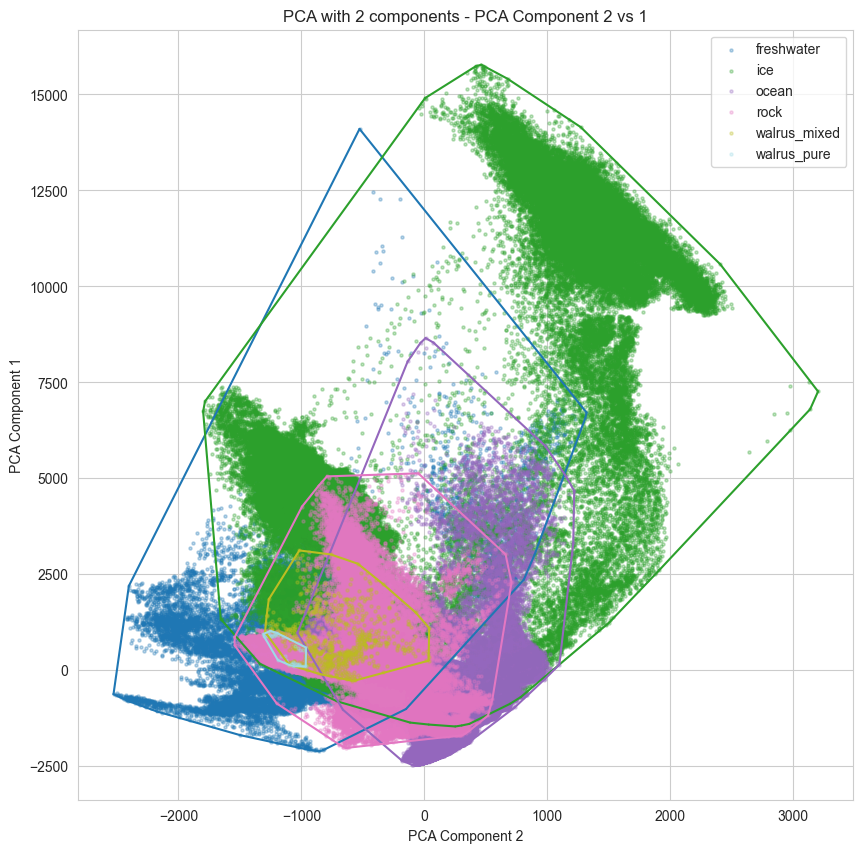

Explained variance ratios for components 1, 2:
[0.94210644 0.04461492]

PCA with 3 components:
Explained variance ratio: [0.94210644 0.04461492 0.00816484]
Cumulative explained variance ratio: 0.9948862058071876


C:\Users\Student\AppData\Local\Temp\ipykernel_19352\1788077875.py:14: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(


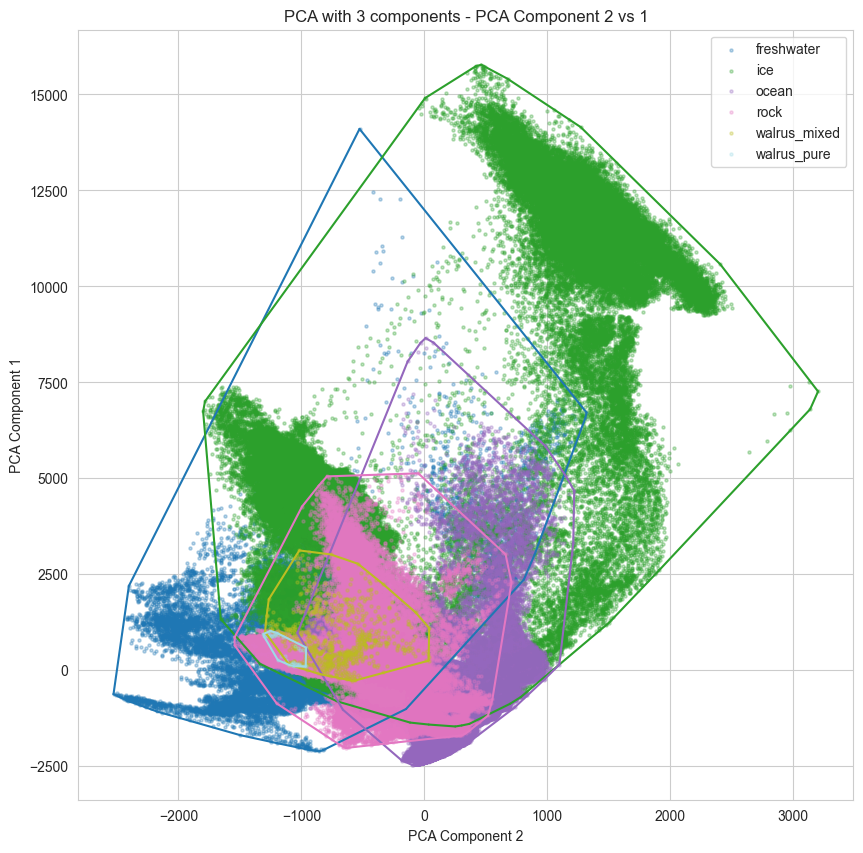

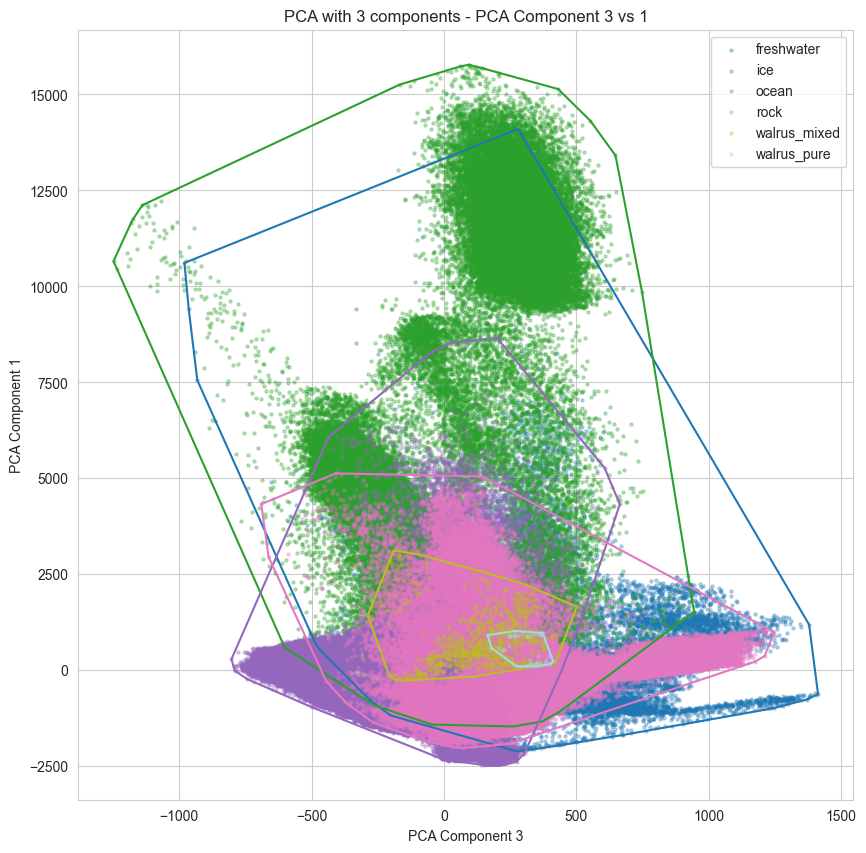

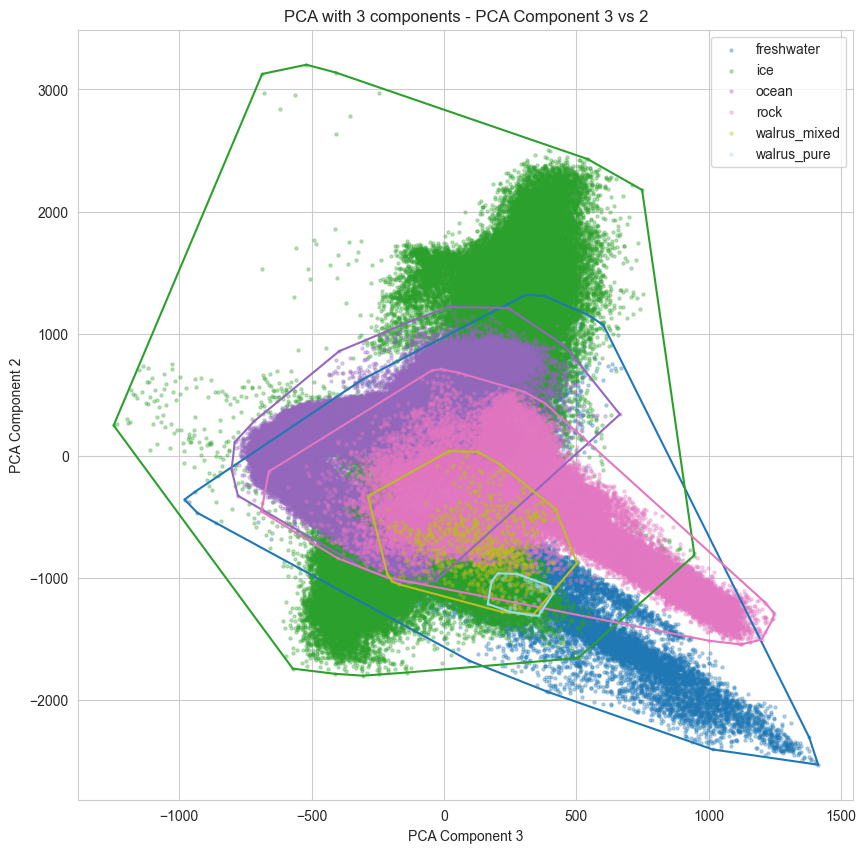

Explained variance ratios for components 1, 2, 3:
[0.94210644 0.04461492 0.00816484]

PCA with 4 components:
Explained variance ratio: [0.94210644 0.04461492 0.00816484 0.00340751]
Cumulative explained variance ratio: 0.9982937144790394


C:\Users\Student\AppData\Local\Temp\ipykernel_19352\1788077875.py:14: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(


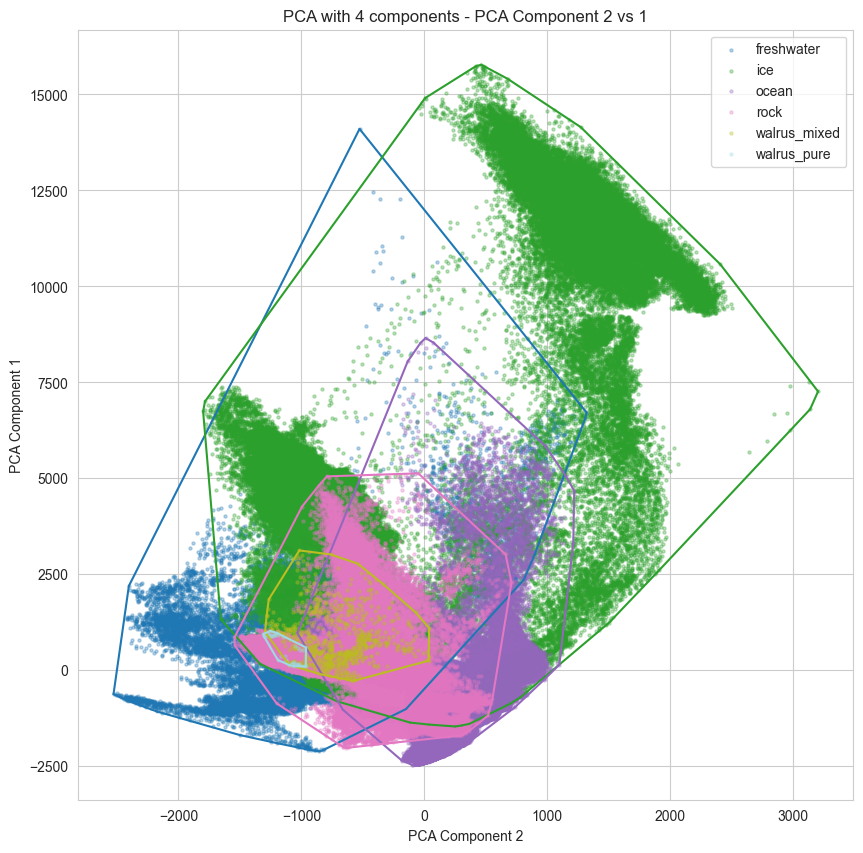

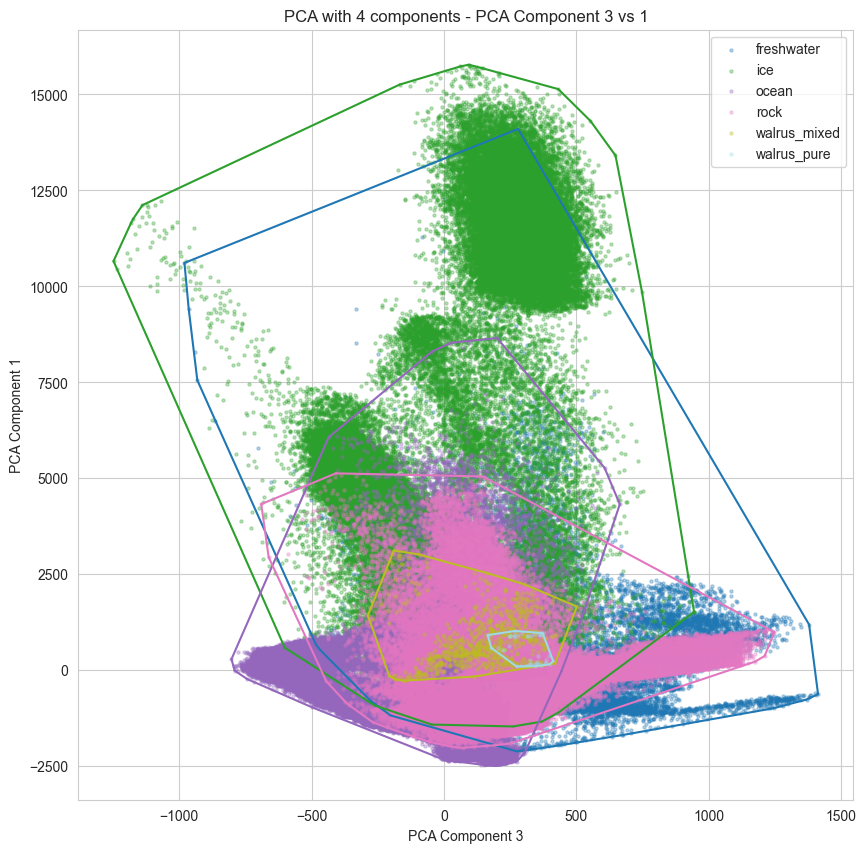

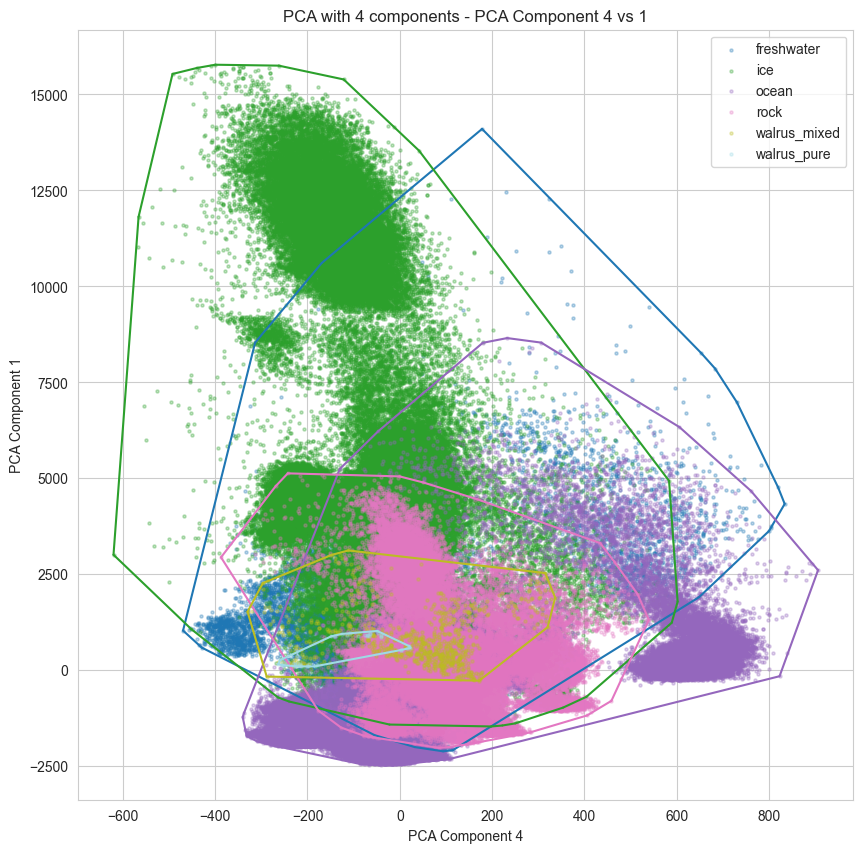

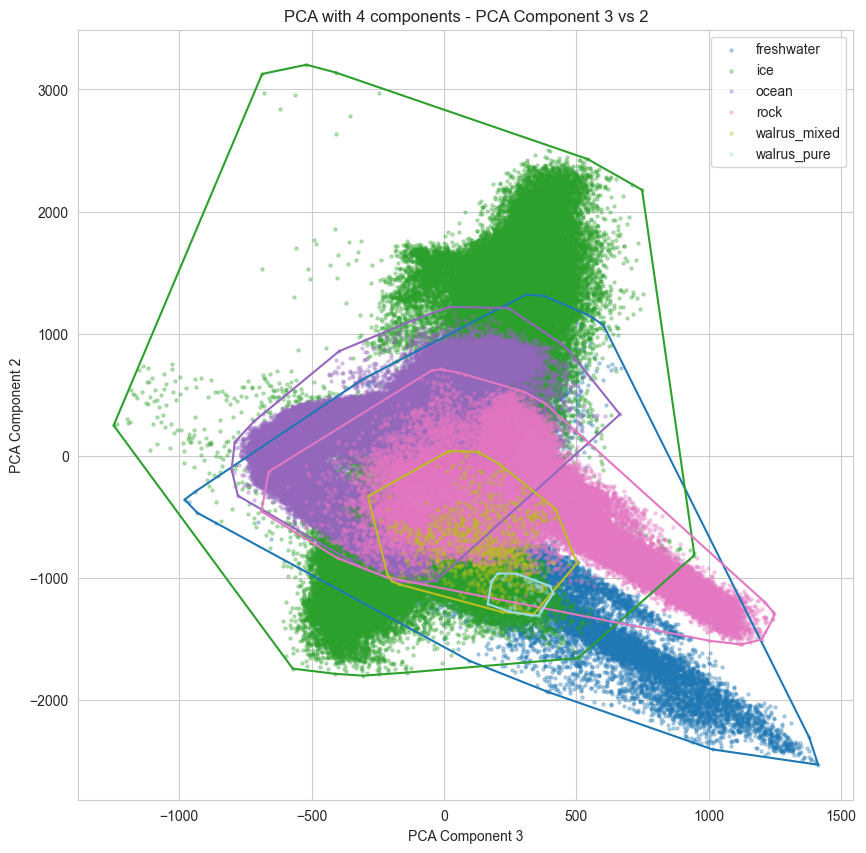

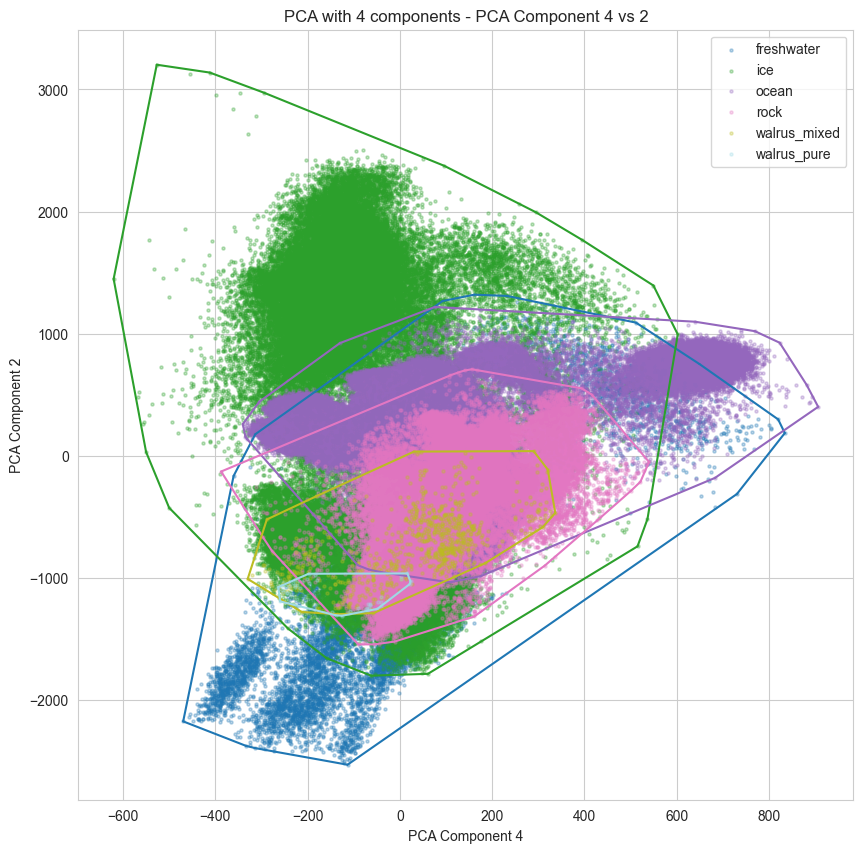

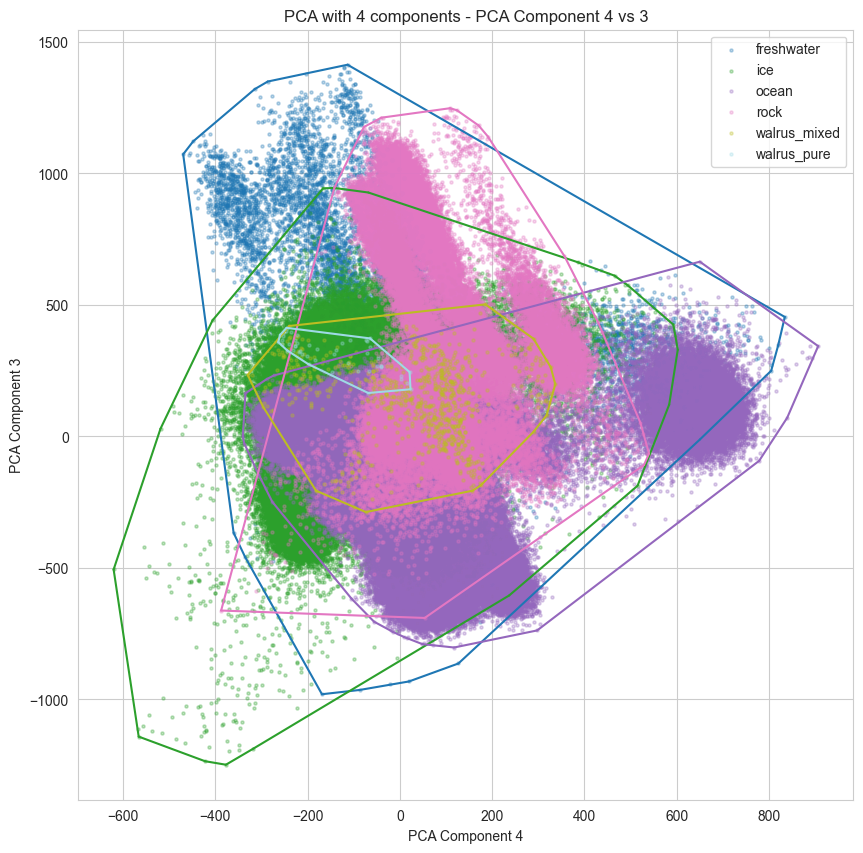

Explained variance ratios for components 1, 2, 3, 4:
[0.94210644 0.04461492 0.00816484 0.00340751]

PCA with 5 components:
Explained variance ratio: [9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04]
Cumulative explained variance ratio: 0.9991365495470521


C:\Users\Student\AppData\Local\Temp\ipykernel_19352\1788077875.py:14: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(


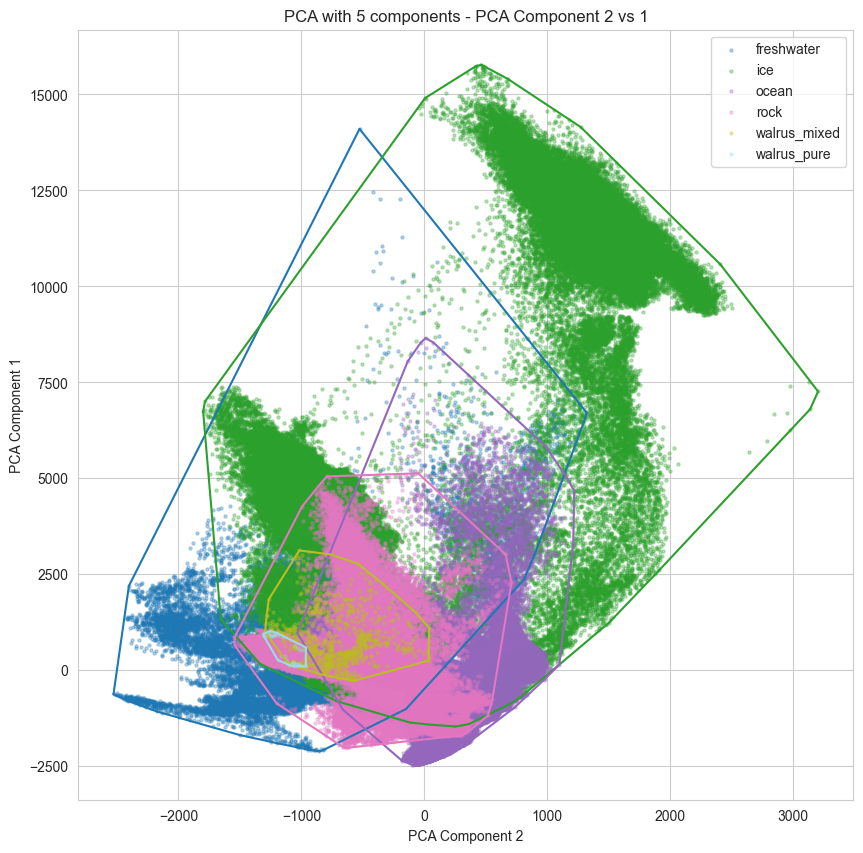

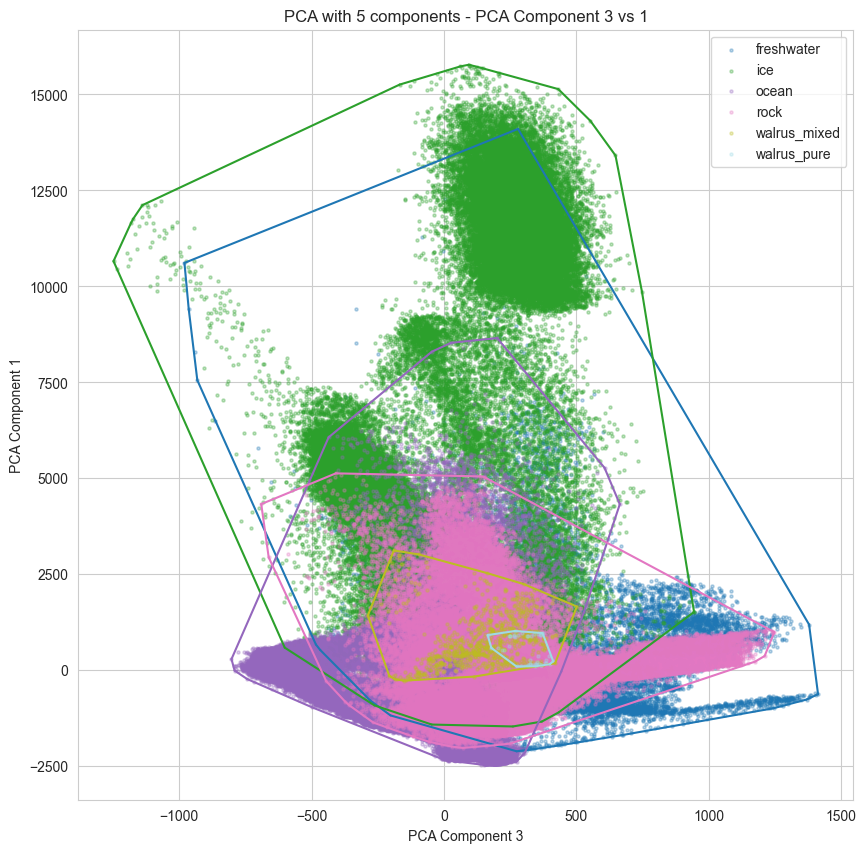

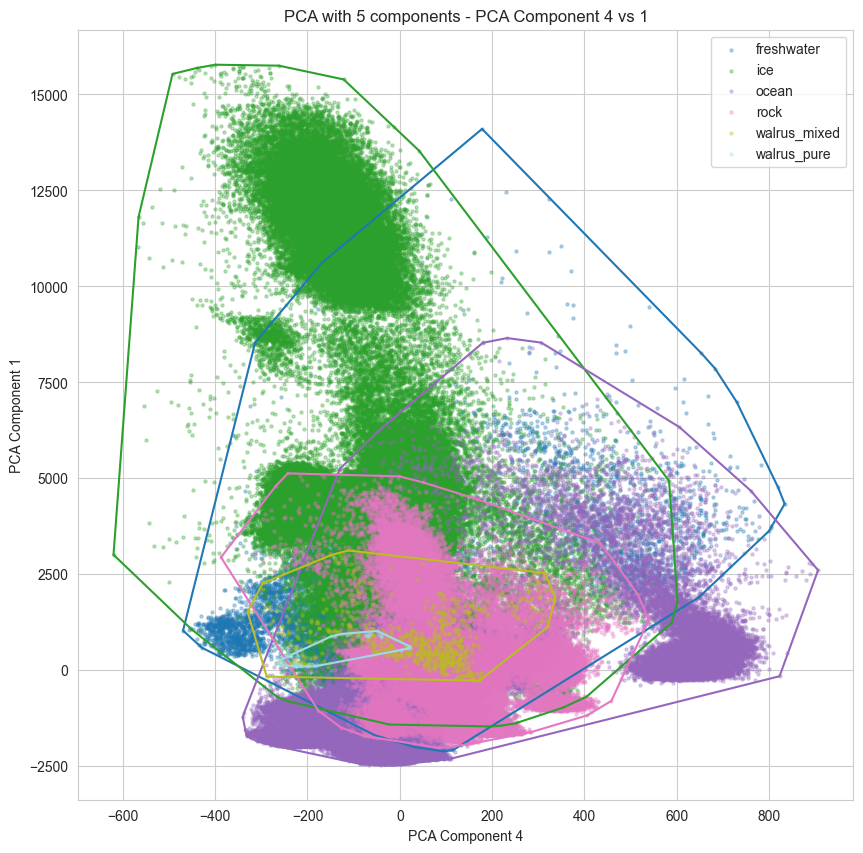

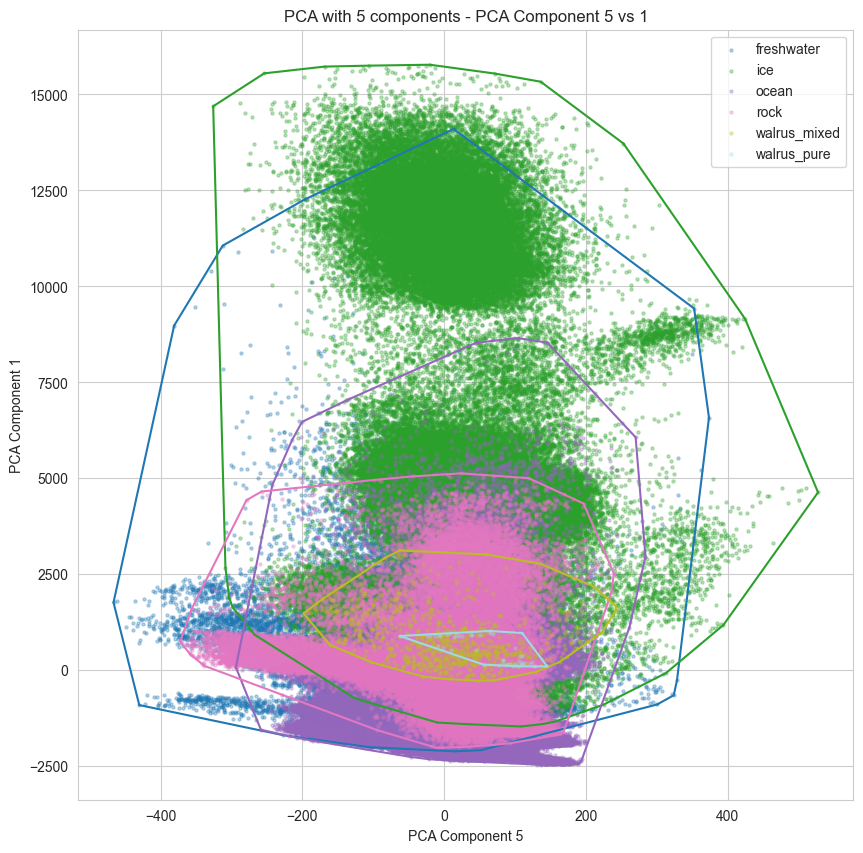

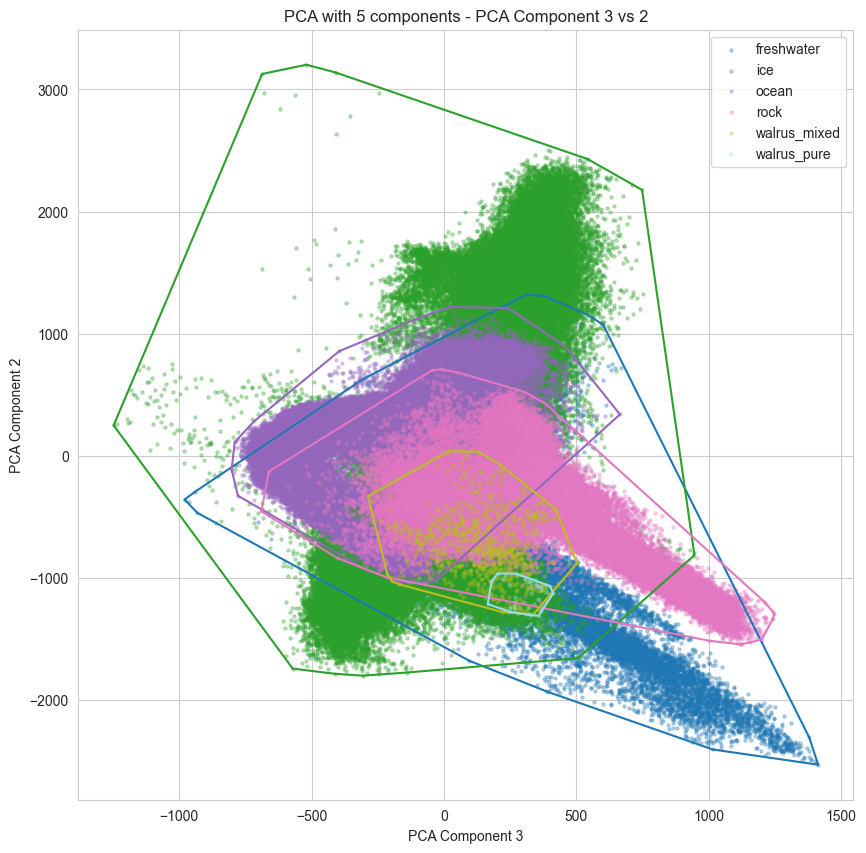

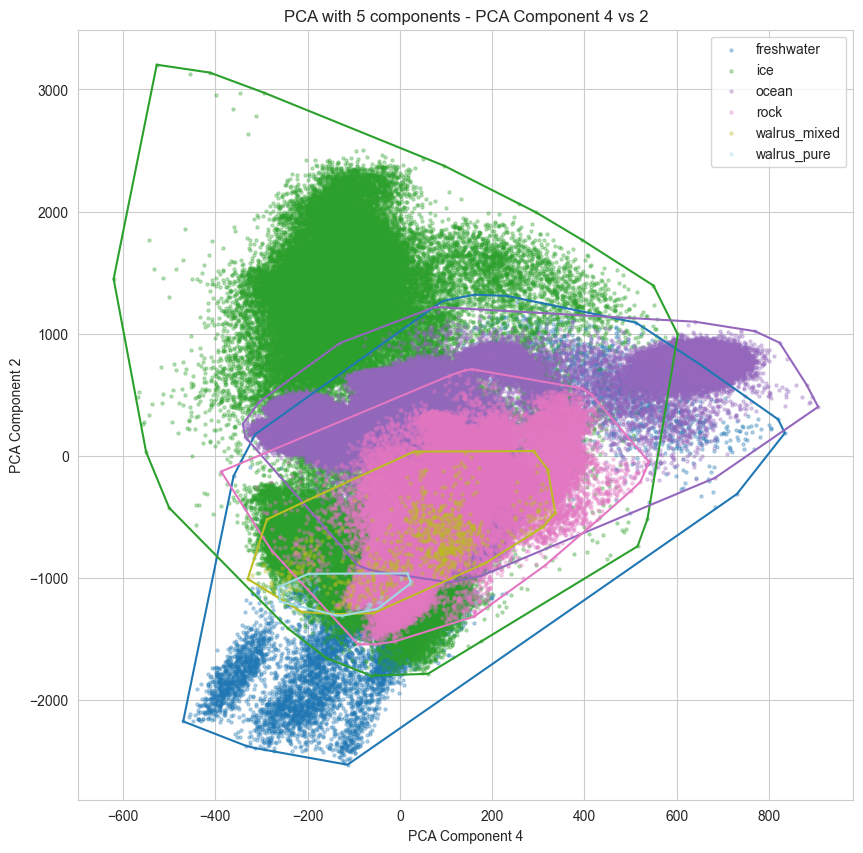

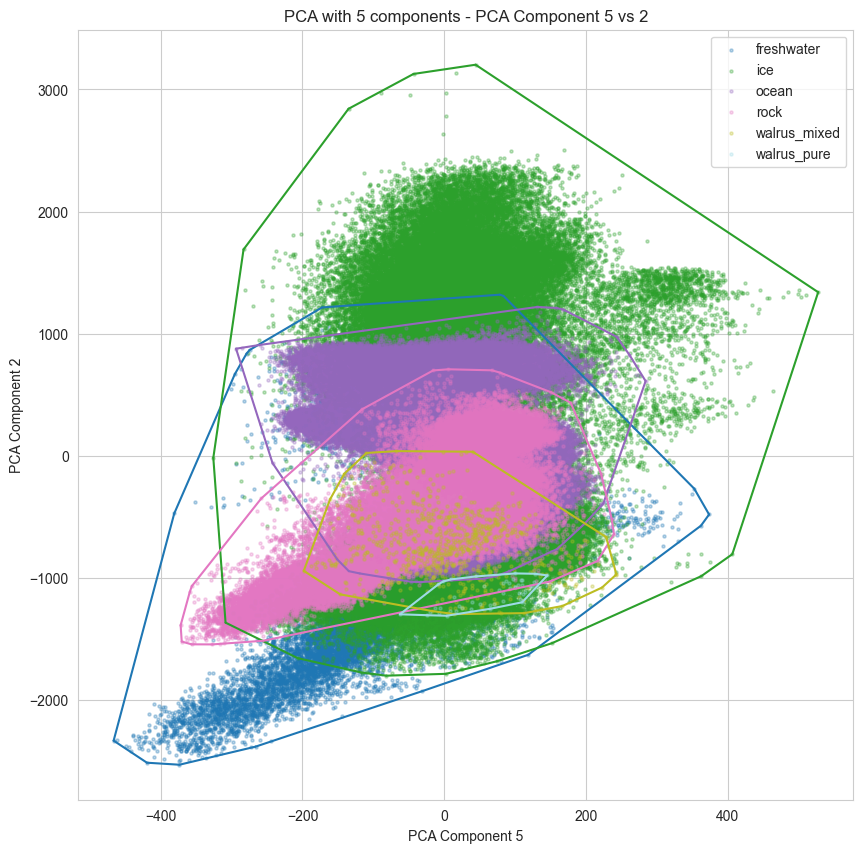

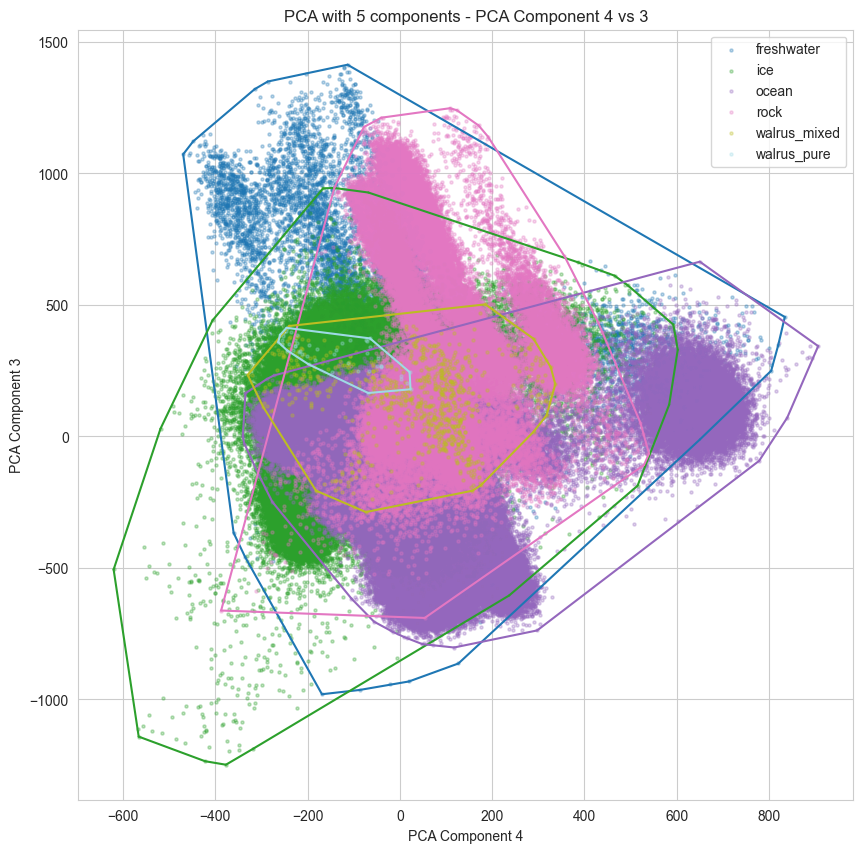

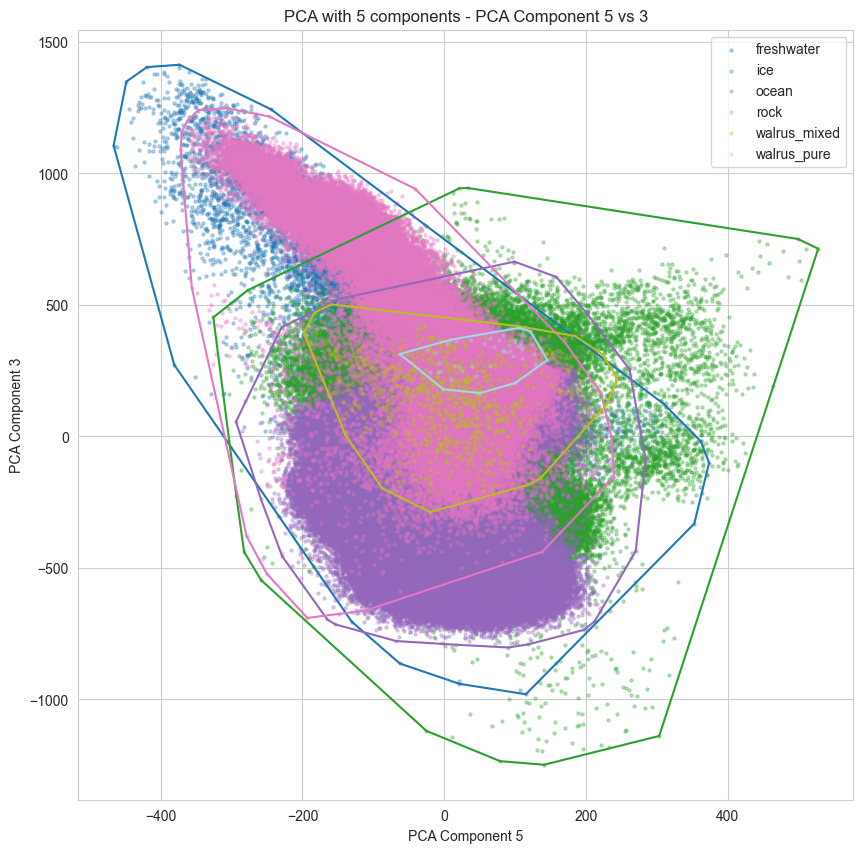

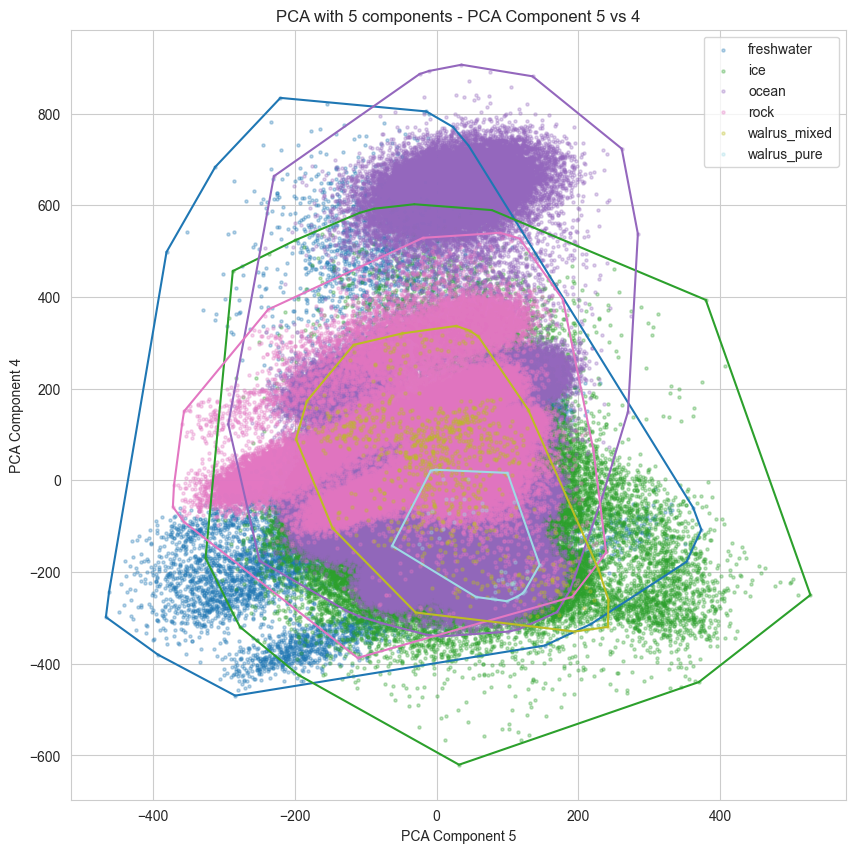

Explained variance ratios for components 1, 2, 3, 4, 5:
[9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04]

PCA with 6 components:
Explained variance ratio: [9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04 4.09254632e-04]
Cumulative explained variance ratio: 0.9995458041795092


C:\Users\Student\AppData\Local\Temp\ipykernel_19352\1788077875.py:14: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(


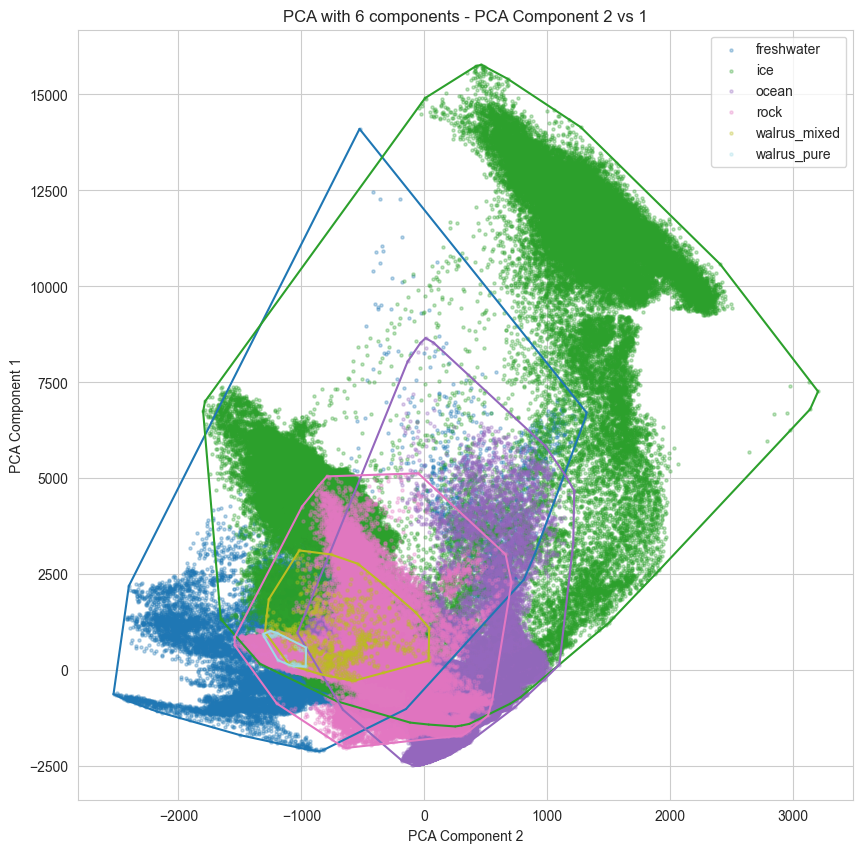

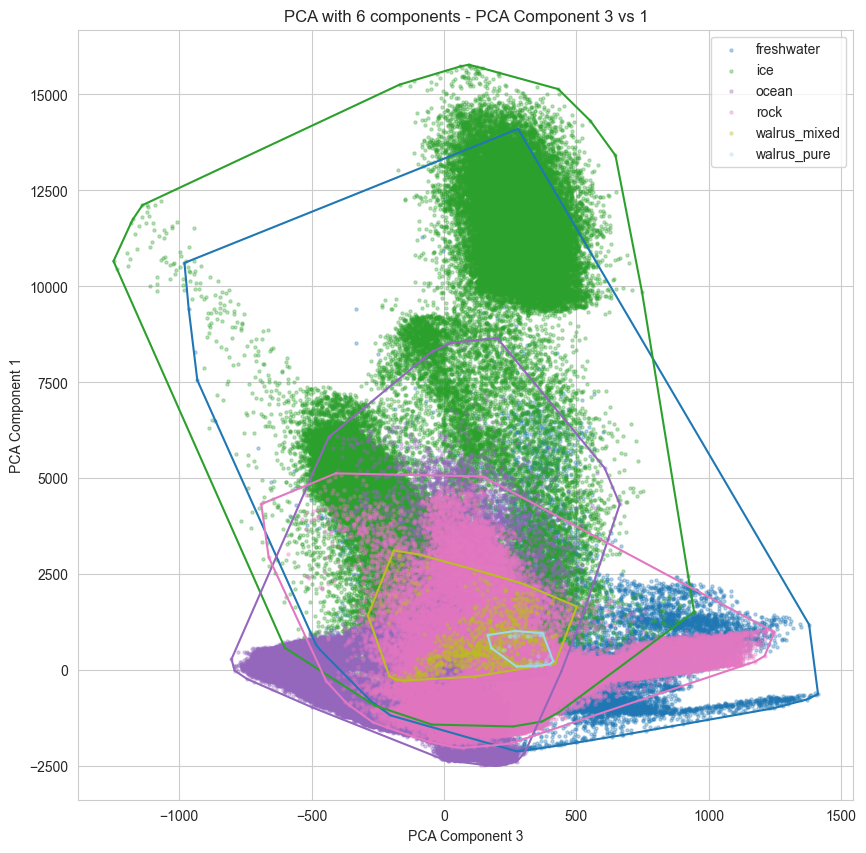

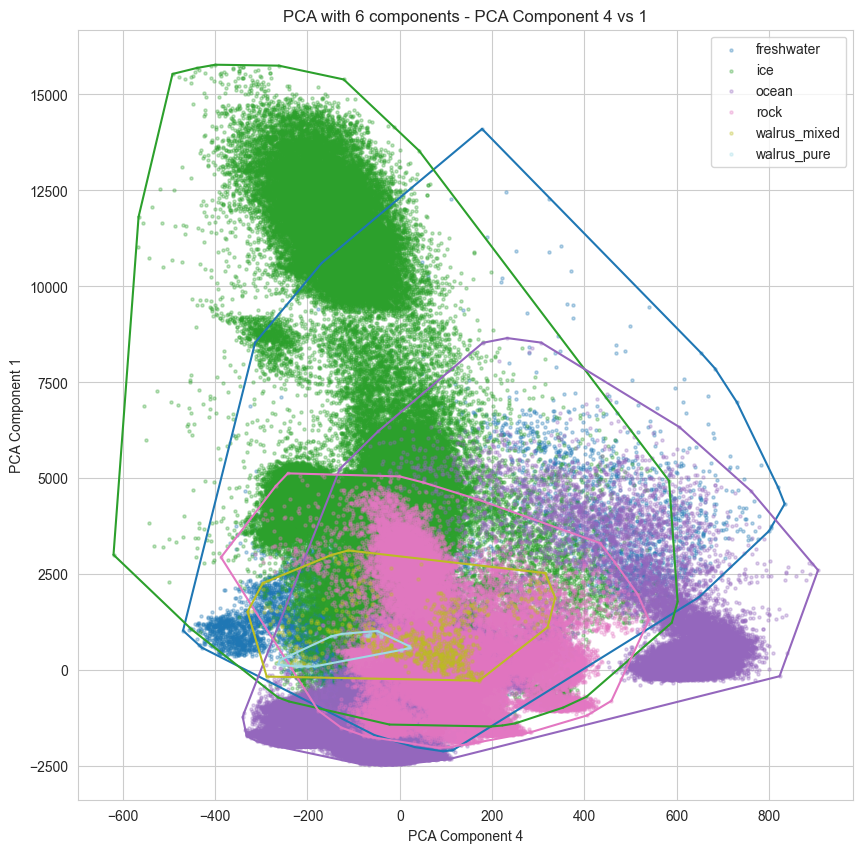

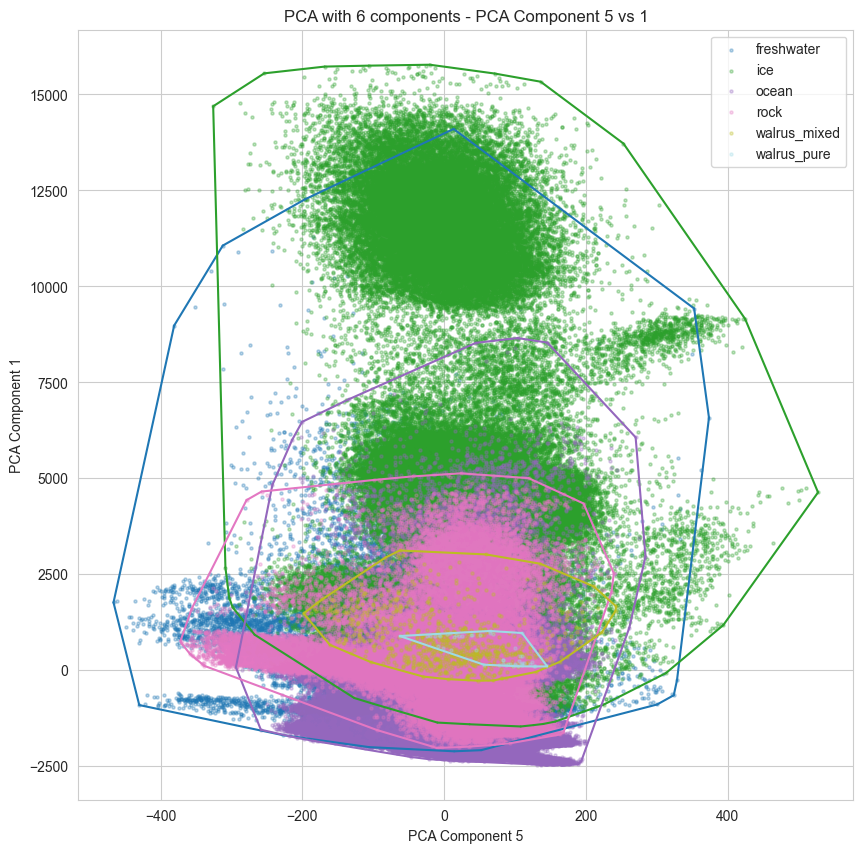

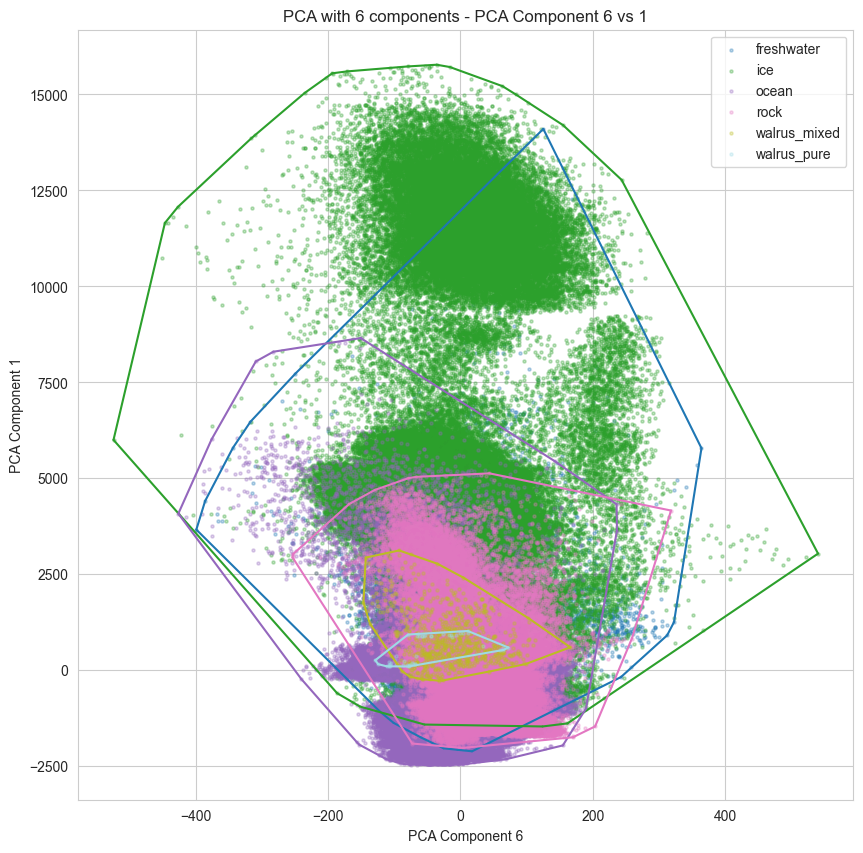

...

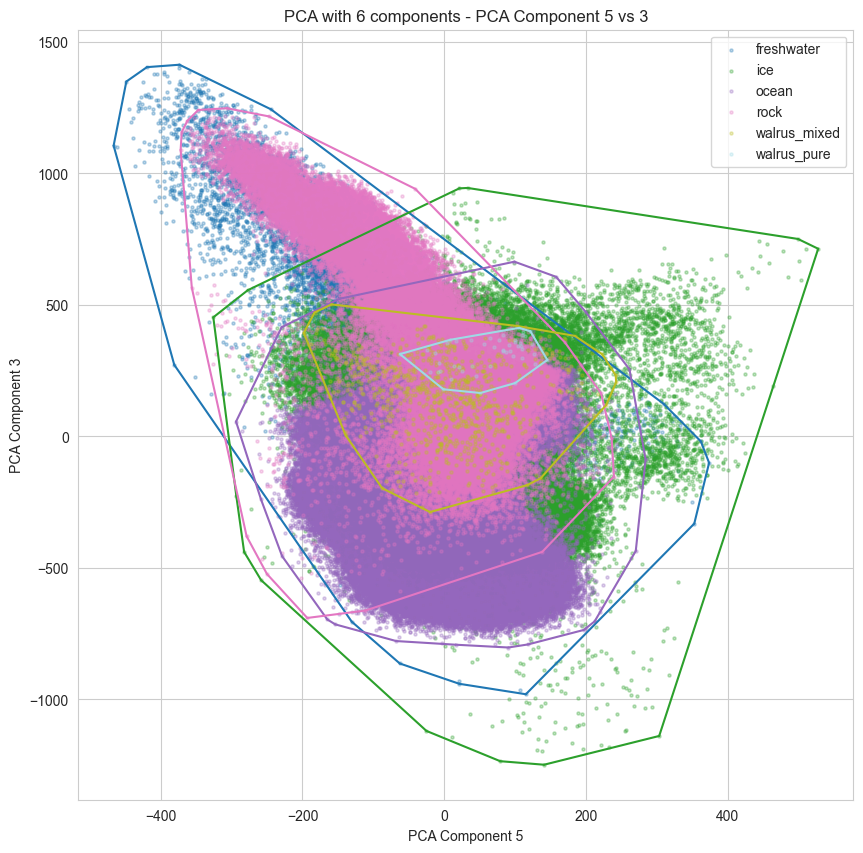

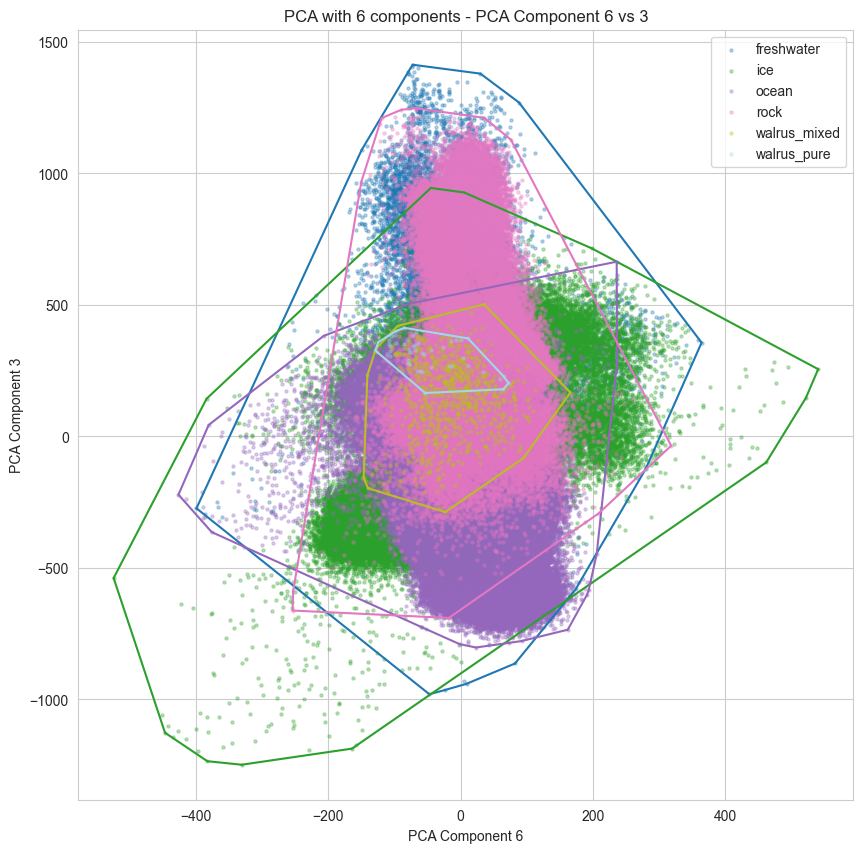

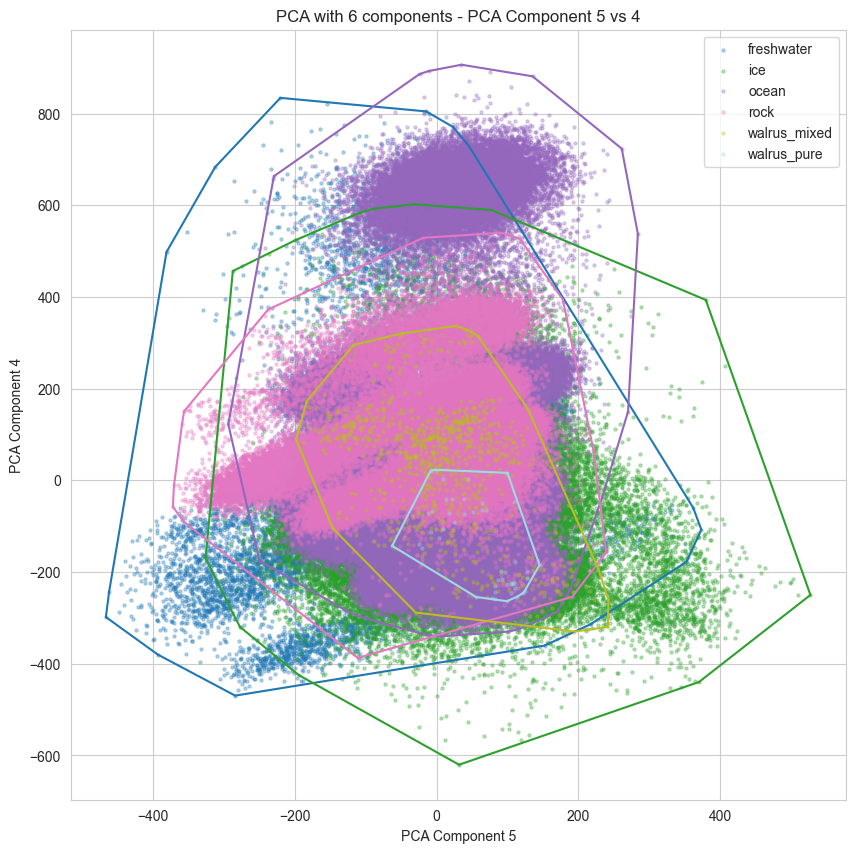

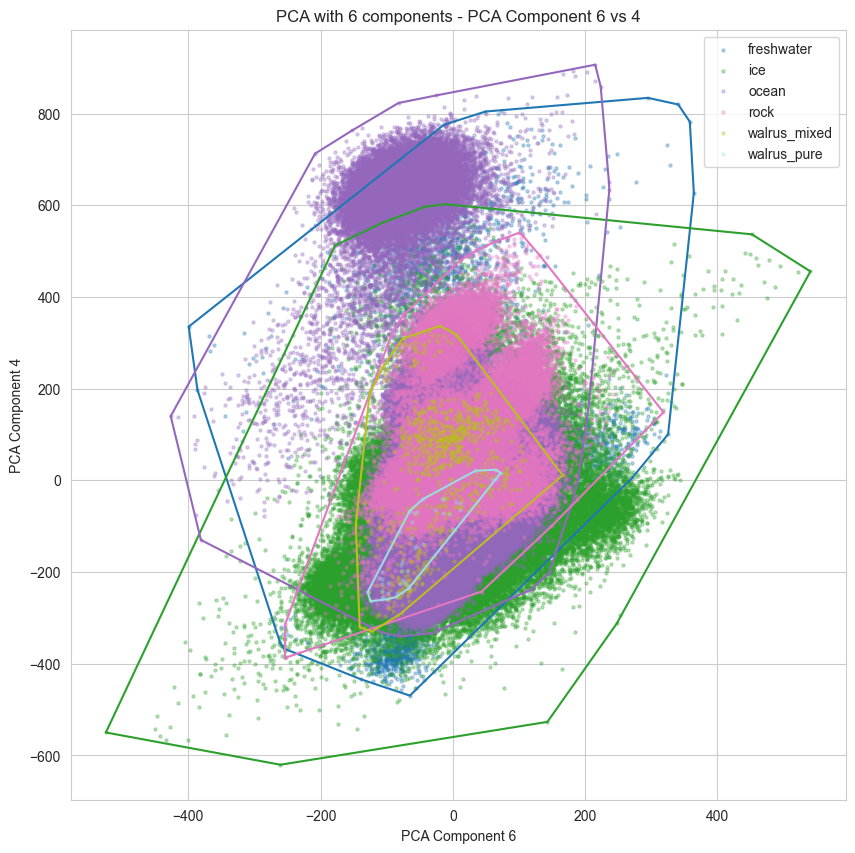

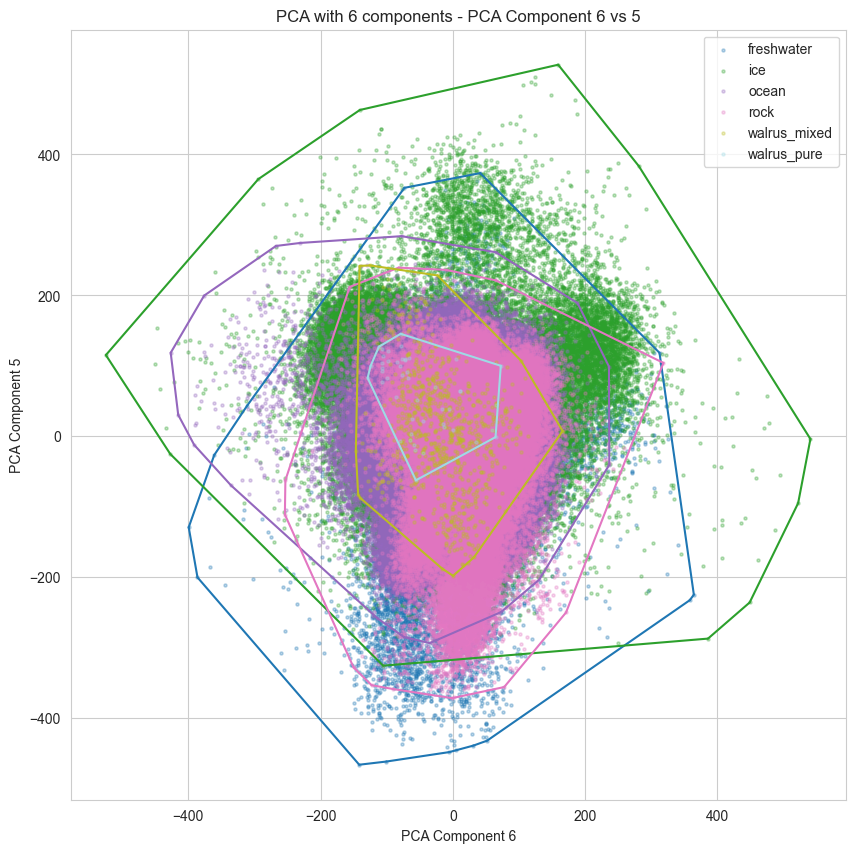

Explained variance ratios for components 1, 2, 3, 4, 5, 6:
[9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04 4.09254632e-04]

PCA with 7 components:
Explained variance ratio: [9.42106445e-01 4.46149215e-02 8.16483955e-03 3.40750867e-03
 8.42835068e-04 4.09254632e-04 2.65229527e-04]
Cumulative explained variance ratio: 0.9998110337064043


C:\Users\Student\AppData\Local\Temp\ipykernel_19352\1788077875.py:14: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(


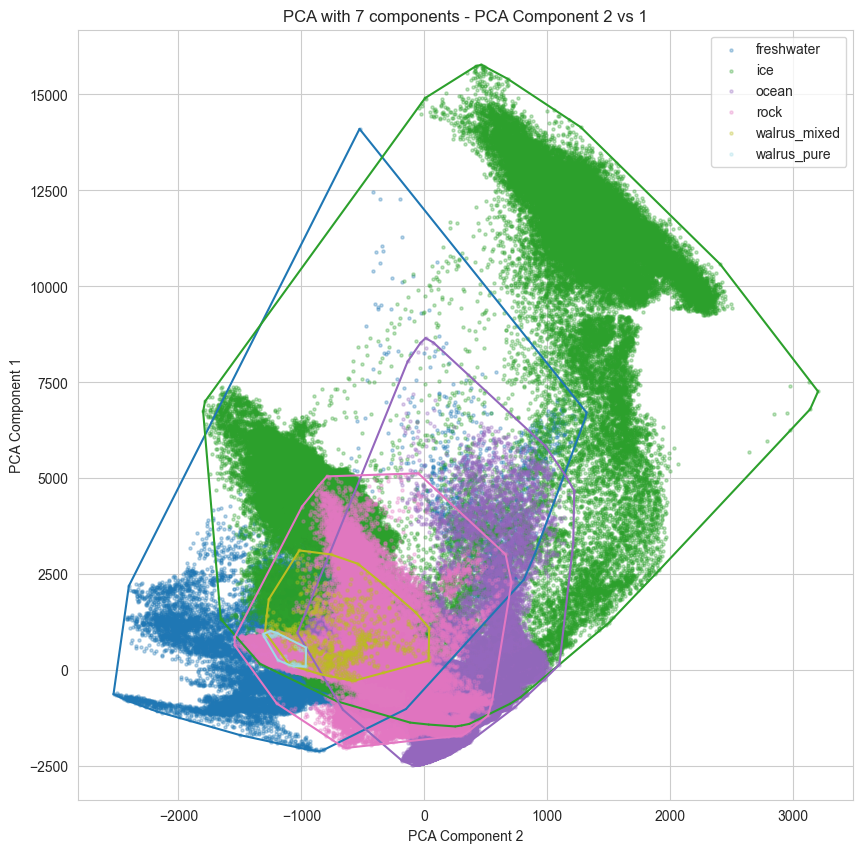

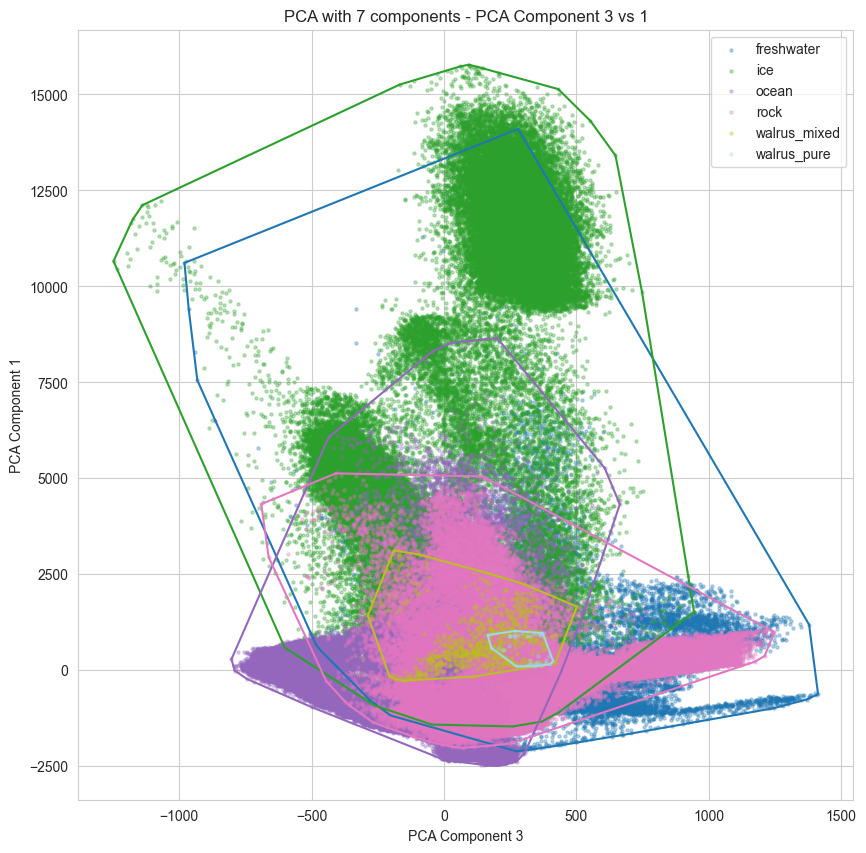

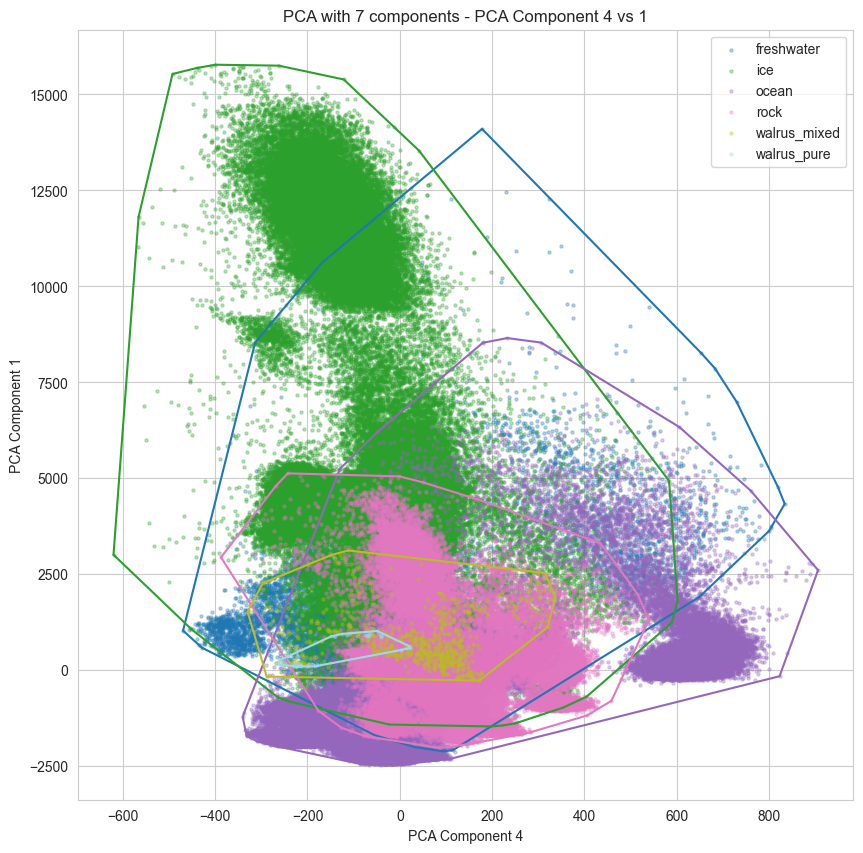

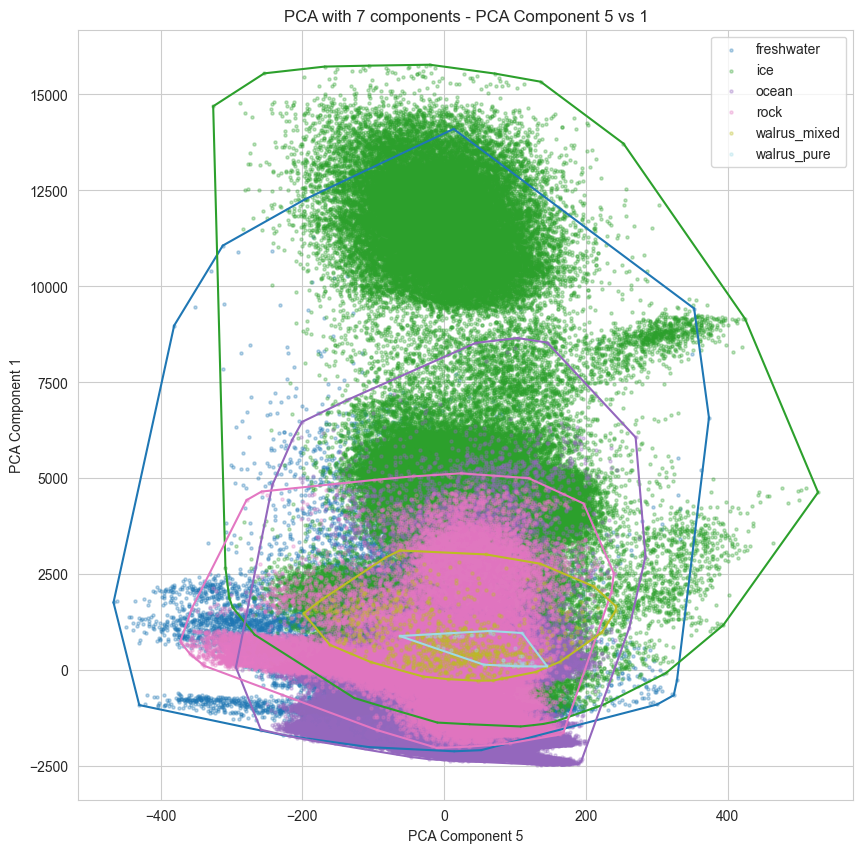

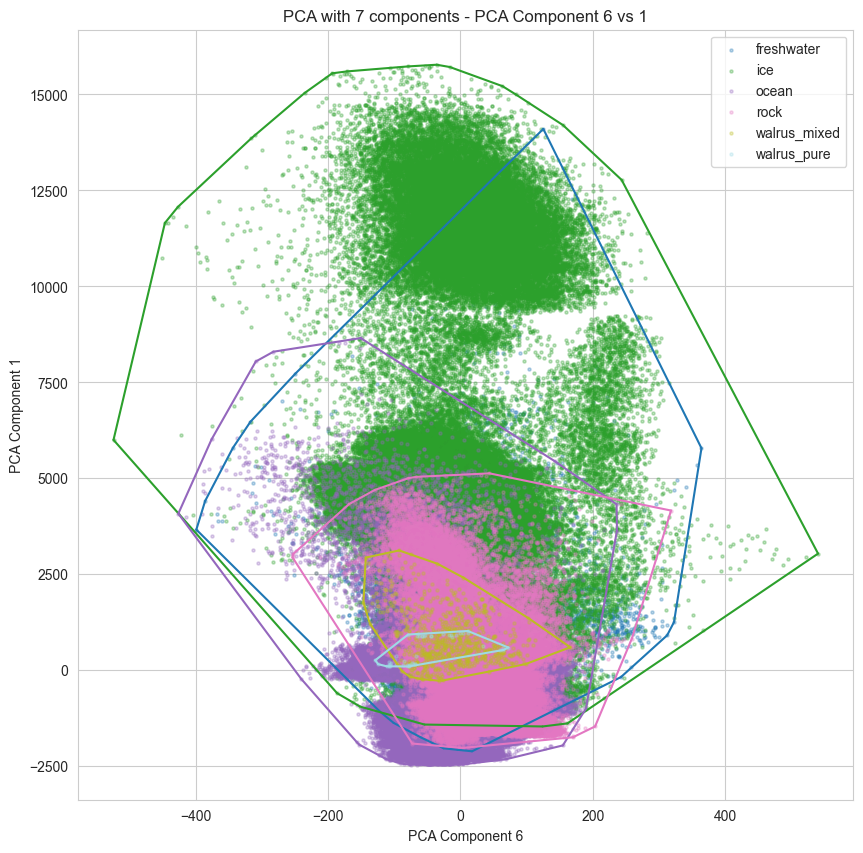

...

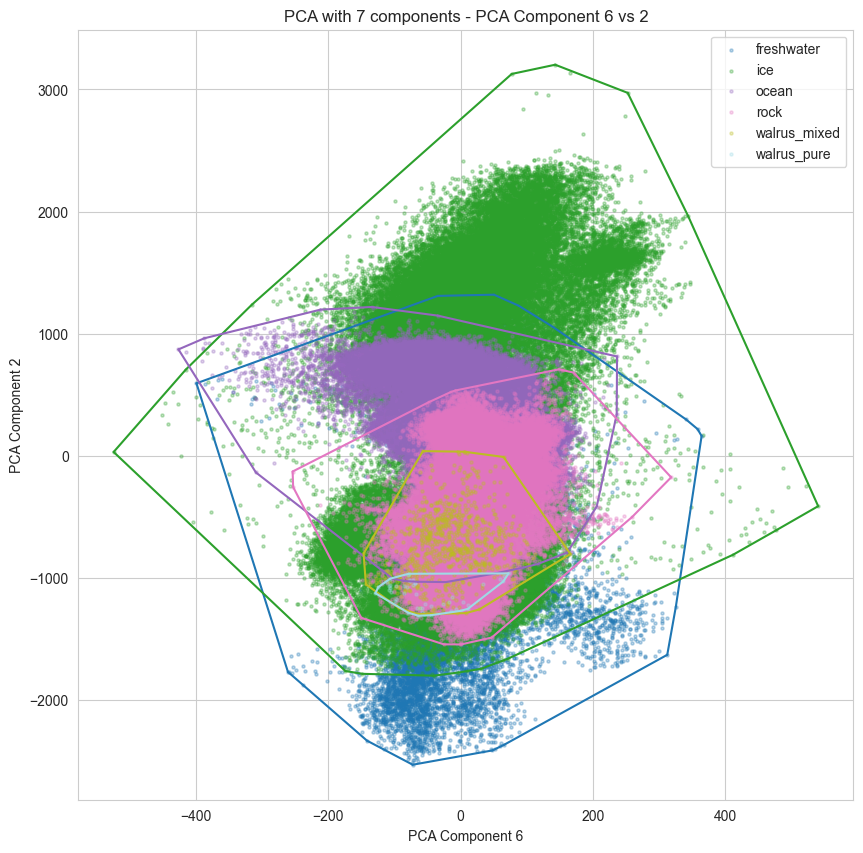

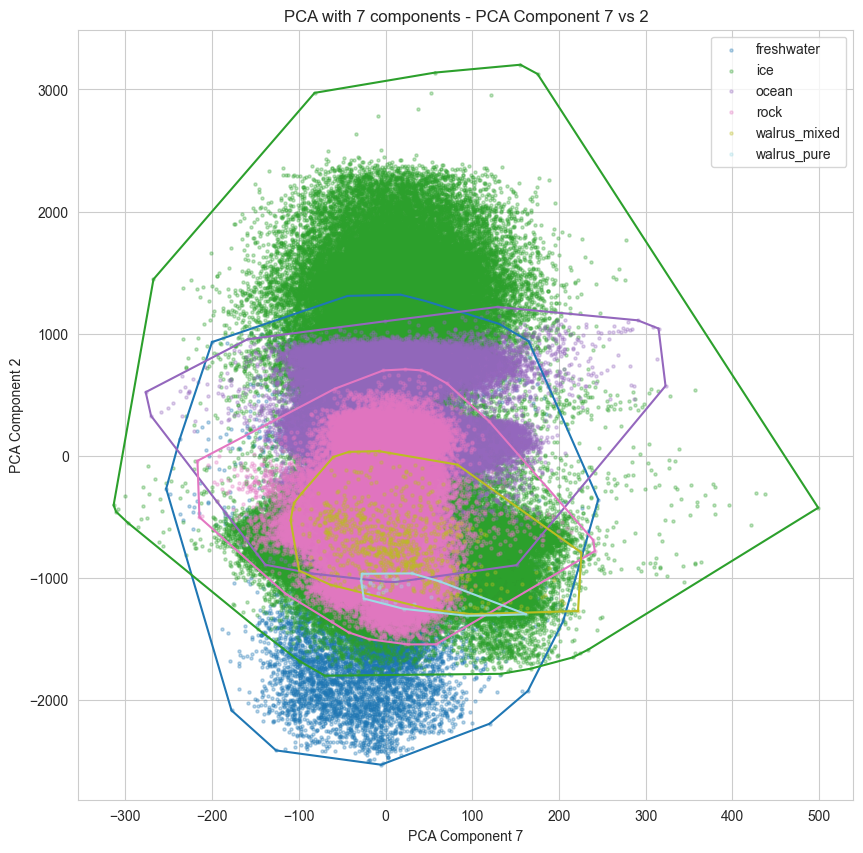

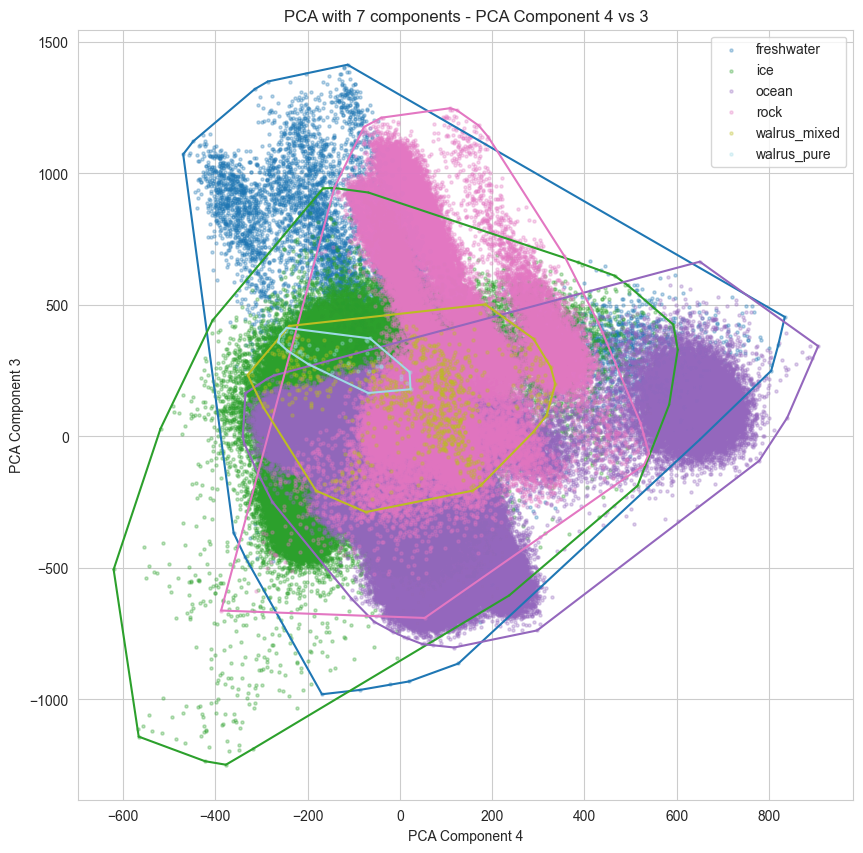

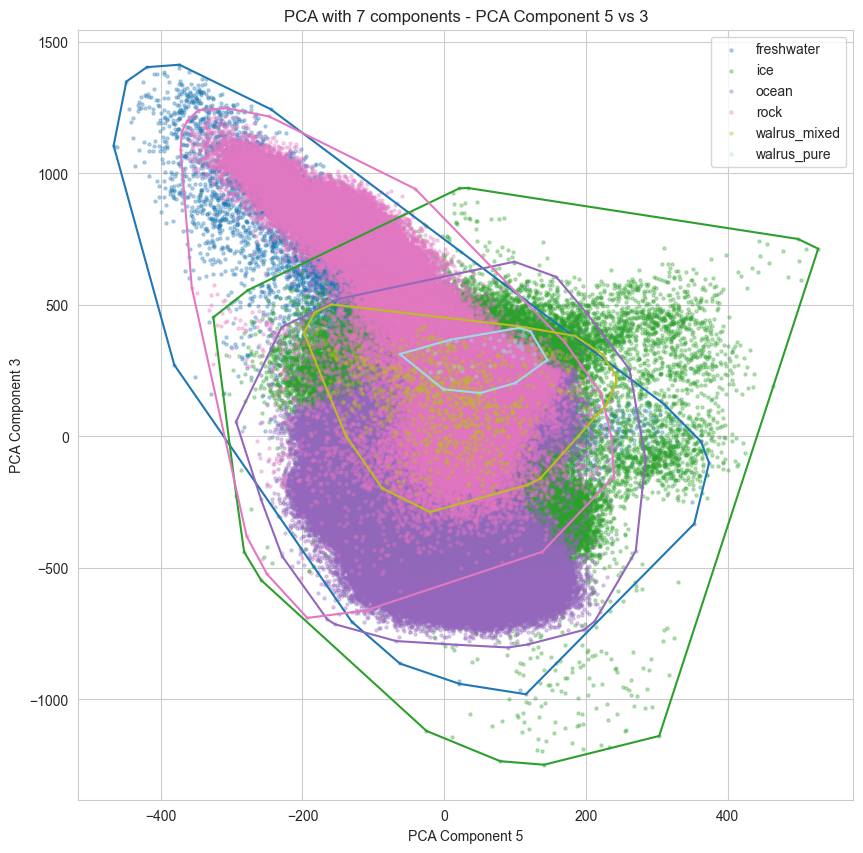

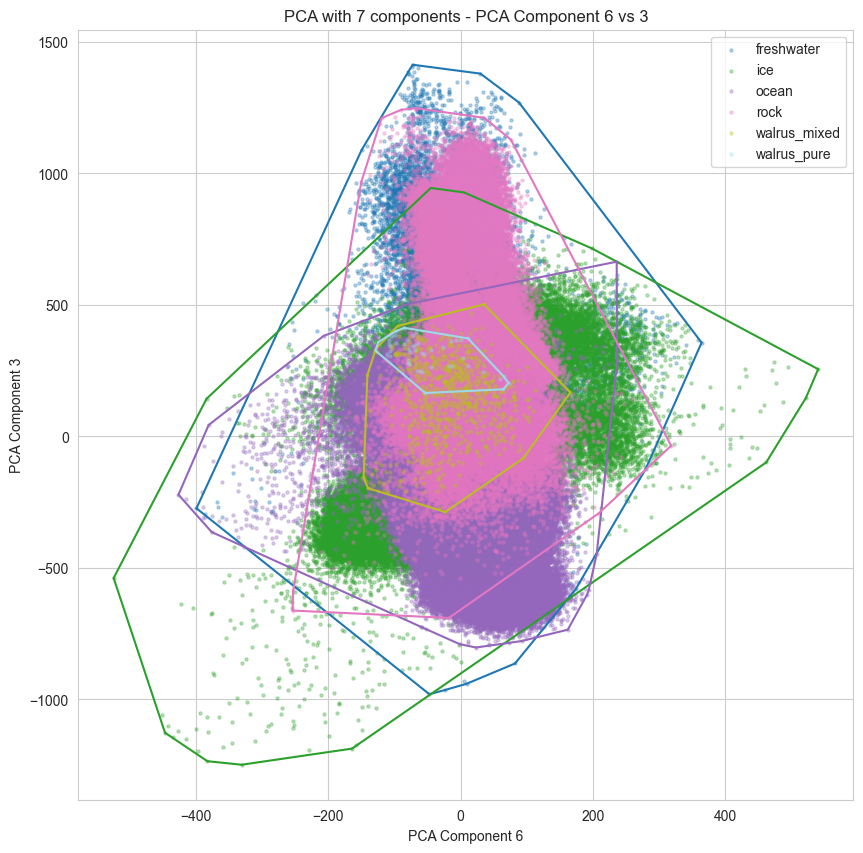

In [ ]:
# Perform PCA with increasing number of components
max_components = min(8, features.shape[1])

for n_components in range(2, max_components + 1):
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(features)
    
    print(f"\nPCA with {n_components} components:")
    print(f"Explained variance ratio: {pca.explained_variance_ratio_}")
    print(f"Cumulative explained variance ratio: {np.sum(pca.explained_variance_ratio_)}")
    
    if n_components == 2:
        plot_pca_components_2d(X_pca, encoded_labels, pca, n_components, f'PCA with {n_components} components', class_names, class_color_map)
    else:
        plot_pca_components_2d(X_pca, encoded_labels, pca, n_components, f'PCA with {n_components} components', class_names, class_color_map)
        # Assuming `plot_interactive_3d` is defined elsewhere
        # plot_interactive_3d(X_pca, encoded_labels, pca, f'PCA with {n_components} components', class_names, class_color_map)

# Plot explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(range(1, max_components + 1), np.cumsum(pca.explained_variance_ratio_), 'o-', color='dimgray')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Explained Variance Ratio vs. Number of PCA Components')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

# Scatter plot matrix for all components
plt.figure(figsize=(20, 20))
sns.pairplot(pd.DataFrame(X_pca, columns=[f'PC{i+1}' for i in range(X_pca.shape[1])]).assign(Class=[class_names[label] for label in encoded_labels]),
             hue='Class', plot_kws={'alpha': 0.3, 's': 5})
plt.suptitle('Scatter Plot Matrix of PCA Components', y=1.02)
plt.show()

In [ ]:
# Define the color map
label_colors = {'ice': 'antiquewhite', 'rock': 'dimgray', 'walrus_pure': 'fuchsia', 'walrus_mixed': 'hotpink', 'freshwater': 'aquamarine', 'ocean': 'cornflowerblue'}
class_names = le.classes_
class_color_map = {class_name: label_colors[class_name] for class_name in class_names}

def plot_pca_components_2d(X_pca, y, pca, n_components, label='Classes', class_names=None, color_map=None):
    # Get the indices of the components that explain the most variance
    top_components = pca.explained_variance_ratio_.argsort()[-n_components:][::-1]
    
    for i, j in itertools.combinations(range(n_components), 2):
        plt.figure(figsize=(10, 10))
        for l in np.unique(y):
            class_mask = y == l
            plt.scatter(
                X_pca[class_mask, top_components[j]],
                X_pca[class_mask, top_components[i]],
                c=color_map[class_names[l]] if color_map else 'black',
                label=class_names[l] if class_names is not None else l,
                s=5,
                alpha=0.3
            )
            if class_mask.sum() > 2:  # Check if there are enough points to form a hull
                hull = ConvexHull(X_pca[class_mask][:, [top_components[j], top_components[i]]])
                for simplex in hull.simplices:
                    plt.plot(X_pca[class_mask][simplex, top_components[j]],
                             X_pca[class_mask][simplex, top_components[i]], color=color_map[class_names[l]] if color_map else 'black')
        plt.xlabel(f'PCA Component {top_components[j]+1}')
        plt.ylabel(f'PCA Component {top_components[i]+1}')
        plt.title(f'{label} - PCA Component {top_components[j]+1} vs {top_components[i]+1}')
        plt.legend()
        plt.show()

    # Print the explained variance for the plotted components
    print(f"Explained variance ratios for components {', '.join(str(i+1) for i in top_components)}:")
    print(pca.explained_variance_ratio_[top_components])

In [ ]:
# Perform PCA with increasing number of components
max_components = min(8, features.shape[1])

for n_components in range(2, max_components + 1):
    pca = PCA(n_components=n_components)
    X_pca = pca.fit_transform(features)
    
    print(f"\nPCA with {n_components} components:")
    print(f"Explained variance ratio: {pca.explained_variance_ratio_}")
    print(f"Cumulative explained variance ratio: {np.sum(pca.explained_variance_ratio_)}")
    
    if n_components == 2:
        plot_pca_components_2d(X_pca, encoded_labels, pca, n_components, f'PCA with {n_components} components', class_names, class_color_map)
    else:
        plot_pca_components_2d(X_pca, encoded_labels, pca, n_components, f'PCA with {n_components} components', class_names, class_color_map)
        # Assuming `plot_interactive_3d` is defined elsewhere
        # plot_interactive_3d(X_pca, encoded_labels, pca, f'PCA with {n_components} components', class_names, class_color_map)

# Plot explained variance ratio
plt.figure(figsize=(10, 6))
plt.plot(range(1, max_components + 1), np.cumsum(pca.explained_variance_ratio_), 'o-', color='dimgray')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Explained Variance Ratio vs. Number of PCA Components')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

# Scatter plot matrix for all components
plt.figure(figsize=(20, 20))
sns.pairplot(pd.DataFrame(X_pca, columns=[f'PC{i+1}' for i in range(X_pca.shape[1])]).assign(Class=[class_names[label] for label in encoded_labels]),
             hue='Class', plot_kws={'alpha': 0.3, 's': 5})
plt.suptitle('Scatter Plot Matrix of PCA Components', y=1.02)
plt.show()